# **Saudi Arabia Used Car Regression Prediction using Machine Learning**

By : Glen Valencius

**Context**

Syarah.com adalah platform bisnis b2c marketplace yang menjual mobil bekas dan juga baru. Syarah.com menjual list mobilnya di website. Syarah.com sendiri beroperasi di Riyadh Saudi Arabia dan berdiri tahun 2015 hingga kini. Melansir dari website Syarah.com pada tahun 2022 Syarah App mendapatkan ranking top 10 most-used app di Saudi Arabia menurut Saudi Ministry of Communications and Information Technology.

Kelebihan dari Syarah.com adalah konsumen dapat membeli dan menjual mobil melalui website atau app dan mobil akan langsung dikirim ke tujuan.

Syarah.com sendiri memiliki fitur untuk menjual mobil ke perusahaan, dan semua prosedur akan dicover oleh perusahaan seperti inspeksi mesin dan juga foto. https://syarah.com/en/sell-trade

Cara user menjual mobil adalah dengan mengisi informasi dasar dari mobil seperti Brand, Model, Tahun Mobil diproduksi, dan Mileage. Di tahap selanjutnya akan dimunculkan perkiraan harga mobil dari apa yang diisi sebelumnya.

Melansir dari berita https://syarah.com/carsguide/en/syarah-series-c-investment/, Syarah.com dalam setahun dapat menjual lebih dari 12.000 mobil. Hal ini tentu saja tidak mudah, dikarenakan setiap mobil yang dijual memerlukan penentuan harga di masing - masing mobil. Harga yang dipilih harus sesuai dengan keadaan dari mobil bekas tersebut.


**Problem Statement**

Salah satu hal yang diperlukan adalah menentukan harga mobil bekas dengan keadaan yang berbeda - beda.

Jika ingin melakukan pengembangan bisnis dengan memperbanyak penjualan, **maka akan semakin banyak pula mobil bekas yang harus diberikan harga**. Bila hanya mengandalkan team maka tidak akan efisien. Oleh karena itu diperlukan sebuah model Machine Learning yang dapat memprediksi harga dari sebuah mobil bekas dengan melihat spesifikasi dari mobil tersebut untuk membantu team dalam menentukan harga mobil.

Untuk meng hire **Appraiser** membutuhkan **SAR 4,000 to SAR 8,000 per month** setiap orang bila ingin menambah pegawai, sedangkan dengan Model akan lebih menghemat pengeluaran perusahaan hanya dengan memantau model saja **Data Scientist SAR 8,000 to SAR 12,000**.

Dikarenakan kita akan memprediksi harga yang dalam bentuk numerical, kita akan menggunakan Model Regressi.

**Stakeholders**

1. Calon Penjual Mobil Bekas
    - Masalah : Penjual kesulitan untuk menentukan harga jual mobilnya
    - Dampak : Mobil tidak laku terjual
2. Team Appraiser
    - Masalah : Semakin banyak mobil yang akan dijual, semakin butuh banyak pegawai untuk melakukan analisa harga
    - Dampak : Semakin sulit pekerjaan dengan beban kerja yang tinggi
3. Perusahaan Syarah.com
    - Masalah : Perusahaan membutuhkan pengeluaran lebih untuk menghire Team Appraiser untuk menilai harga mobil
    - Dampak : Sulit untuk melakukan ekspansi jumlah mobil yang dijual

**Goals**

Berdasarkan permasalah tersebut, Syarah,com perlu memiliki ‘tools’ yang dapat **memprediksi harga mobil sesuai spesifikasi dari mobil tersebut**. Variabel - variabel yang ada di dataset diharapkan dapat memberikan prediksi harga dengan akurasi yang baik dalam menentukan harga mobil.

Model ini dapar digunakan oleh 2 stakeholder yaitu Calon Penjual ketika ingin menjual dan diberikan harga perkiraan dan Team Appraiser sebagai referensi untuk menentukan harga mobil ketika selesai diinspeksi.

Target Metric :
- MAE = < 10.000 SAR
- MAPE = <20
- R2 = > 0.70

**Analytic Approach**

Hal yang perlu kita lakukan adalah menganalisa data untuk mendapatkan pola dari fitur - fitur yang ada, yang membedakan satu mobil dengan mobil lainnya.

Selanjutnya, kita akan membangun model regresi yang akan membantu perusahaan untuk dapat memprediksi harga mobil bekas yang akan dijual di platform yang berguna untuk team Appraiser dalam pekerjaan mereka.


**Metric Evaluation**

detailnya sebagai berikut :
- MAE (Primary metric) : Baik digunakan karena satuannya mengikuti satuan asli data, digunakan jika data terdapat outlier karena tidak akan terpengaruh. Ini akan digunakan sebagai fokus untuk Machine Learning ini karena data terdapat outlier.
- MAPE (Secondary metric): Baik untuk mengetahui persentase error.
- R Square : digunakan untuk mengevaluasi performance sebuah model. Semakin mendekati 1 maka model cocok dengan data, tetapi tidak berarti prediksinya akan bagus
- RMSE : Membebankan hitungan error di data yang outlier, dapat lebih fokus untuk menurunkan error prediksi

Semakin kecil nilai MAE dan MAPE model yang dibuat akan semakin akurat dalam memprediksi harga mobil sesuai dengan limitasi fitur yang digunakan.

## Data Understanding

In [3]:
import numpy as np 
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt

# train test split
from sklearn.model_selection import train_test_split

# encoding
from sklearn.preprocessing import OneHotEncoder
from category_encoders import OrdinalEncoder, BinaryEncoder


# scaling
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, KBinsDiscretizer

# column transformer & pipeline
from sklearn.compose import ColumnTransformer

# from sklearn.pipeline import Pipeline
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler, NearMiss

# Metric Evaluation
from sklearn.model_selection import cross_validate

# algorithm
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LogisticRegression
from xgboost import XGBRegressor
import catboost
from catboost import CatBoostRegressor


# Metric Evaluation
from sklearn.metrics import mean_squared_error, mean_absolute_error,mean_absolute_percentage_error,r2_score

from sklearn.model_selection import cross_validate

# hyperparameter tuning
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV


# ensemble
from sklearn.ensemble import VotingRegressor, StackingRegressor

pd.set_option('display.float_format', '{:.2f}'.format)
pd.set_option('display.max_columns', None)

In [4]:
df = pd.read_csv('data_saudi_used_cars.csv')
df.head()

,Type,Region,Make,Gear_Type,Origin,Options,Year,Engine_Size,Mileage,Negotiable,Price
0,Corolla,Abha,Toyota,Manual,Saudi,Standard,2013,1.40,421000,True,0
1,Yukon,Riyadh,GMC,Automatic,Saudi,Full,2014,8.00,80000,False,120000
2,Range Rover,Riyadh,Land Rover,Automatic,Gulf Arabic,Full,2015,5.00,140000,False,260000
3,Optima,Hafar Al-Batin,Kia,Automatic,Saudi,Semi Full,2015,2.40,220000,False,42000
4,FJ,Riyadh,Toyota,Automatic,Saudi,Full,2020,4.00,49000,True,0


- Dataset merupakan data mobil bekas yang dijual di Syarah.com
- Setiap baris data merepresentasikan informasi terkait mobil bekas.

**Attributes Information**

| **Attribute** | **Data Type** | **Description** |
| --- | --- | --- |
| Type | Object | Type of Car |
| Region | Object | The region in which the used car was offered for sale |
| Make | Object | Company Name |
| Gear Type | Object | Gear type size of used car|
| Origin | Object | Origin of used car |
| Options | Object | Options of used car (How many feature in the car) |
| Year | Integer | Manufacturing year |
| Engine_Size | Float | The engine size of used car |
| Mileage | Integer | Total distance a vehicle has traveled or its fuel efficiency (miles per gallon) |
| Negotiable | Booleans | True if the price is 0, that means it is negotiable |
| Price | Integer | Used car price. (in riyal) | 

<br>

In [5]:
shapeawal = df.shape

In [6]:
pd.set_option('display.max_colwidth', None)
listItem = []
for col in df.columns :
    listItem.append( [col, df[col].nunique(), df[col].unique()])

tabel1Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                     data=listItem)
tabel1Desc

,Column Name,Number of Unique,Unique Sample
0,Type,347,"[Corolla, Yukon, Range Rover, Optima, FJ, CX3, Cayenne S, Sonata, Avalon, LS, C300, Land Cruiser, Hilux, Tucson, Caprice, Sunny, Pajero, Azera, Focus, 5, Spark, Camry, Pathfinder, Accent, ML, Tahoe, Yaris, Suburban, A, Altima, Traverse, Expedition, Senta fe, Liberty, 3, X, Elantra, Land Cruiser Pickup, VTC, Malibu, The 5, A8, Patrol, Grand Cherokee, SL, Previa, SEL, Aveo, MKZ, Victoria, Datsun, Flex, GLC, ES, Edge, 6, Escalade, Innova, Navara, H1, G80, Carnival, Symbol, Camaro, Accord, Avanza, Land Cruiser 70, Taurus, C5700, Impala, Optra, S, Other, Cerato, Furniture, Murano, Explorer, LX, Pick up, Charger, H6, BT-50, Hiace, Ranger, Fusion, Rav4, Ciocca, CX9, Kona, Sentra, Sierra, Durango, CT-S, Sylvian Bus, Navigator, Opirus, Marquis, The 7, FX, Creta, ...]"
1,Region,27,"[Abha, Riyadh, Hafar Al-Batin, Aseer, Makkah, Dammam, Yanbu, Al-Baha, Jeddah, Hail, Khobar, Al-Ahsa, Jazan, Al-Medina, Al-Namas, Tabouk, Taef, Qassim, Arar, Jubail, Sabya, Al-Jouf, Najran, Wadi Dawasir, Qurayyat, Sakaka, Besha]"
2,Make,58,"[Toyota, GMC, Land Rover, Kia, Mazda, Porsche, Hyundai, Lexus, Chrysler, Chevrolet, Nissan, Mitsubishi, Ford, MG, Mercedes, Jeep, BMW, Audi, Lincoln, Cadillac, Genesis, Renault, Honda, Suzuki, Zhengzhou, Dodge, HAVAL, INFINITI, Isuzu, Changan, Aston Martin, Mercury, Great Wall, Other, Rolls-Royce, MINI, Volkswagen, BYD, Geely, Victory Auto, Classic, Jaguar, Daihatsu, Maserati, Hummer, GAC, Lifan, Bentley, Chery, Peugeot, Foton, Škoda, Fiat, Iveco, SsangYong, FAW, Tata, Ferrari]"
3,Gear_Type,2,"[Manual, Automatic]"
4,Origin,4,"[Saudi, Gulf Arabic, Other, Unknown]"
5,Options,3,"[Standard, Full, Semi Full]"
6,Year,50,"[2013, 2014, 2015, 2020, 2019, 2012, 2016, 1998, 2011, 2008, 1982, 1985, 2018, 1983, 2021, 2017, 2002, 2010, 2009, 2004, 2001, 1986, 2007, 1999, 2005, 1977, 1991, 2003, 1995, 2006, 1997, 1993, 1996, 2000, 1990, 1965, 1980, 1987, 1994, 1988, 1989, 1978, 2022, 1975, 1964, 1984, 1979, 1992, 1963, 1981]"
7,Engine_Size,71,"[1.4, 8.0, 5.0, 2.4, 4.0, 2.0, 4.8, 3.5, 4.6, 5.7, 2.7, 1.0, 3.0, 1.6, 1.5, 3.3, 6.2, 2.5, 5.3, 3.6, 5.4, 1.7, 3.7, 9.0, 4.7, 4.5, 3.8, 5.5, 2.6, 1.8, 1.2, 6.0, 6.9, 3.2, 5.9, 2.2, 5.6, 1.1, 2.9, 4.1, 1.3, 4.4, 2.8, 3.4, 8.8, 6.1, 7.0, 1.9, 7.5, 4.3, 6.5, 3.1, 6.3, 6.4, 5.8, 8.5, 2.3, 6.6, 7.2, 4.2, 5.1, 7.4, 5.2, 2.1, 6.7, 7.8, 3.9, 8.7, 4.9, 6.8, 8.9]"
8,Mileage,1716,"[421000, 80000, 140000, 220000, 49000, 25000, 189000, 155, 110864, 300, 200, 79000, 299000, 17000, 209, 340000, 30000, 71000, 85000, 500000, 290, 74715, 250, 284000, 98000, 3400, 108, 350000, 550000, 204000, 139240, 296, 105920, 187000, 10000, 18500, 292000, 280000, 270000, 345500, 110000, 247000, 55800, 92000, 27000, 600000, 307801, 62000, 38000, 89000, 137000, 422000, 208000, 11000, 245000, 500, 150000, 81000, 156000, 42000, 228000, 24000, 266000, 98100, 182000, 210800, 88000, 214000, 82808, 4000, 417970, 70000, 115, 270373, 91440, 45000, 96000, 50100, 35449, 180, 66200, 100, 349000, 168000, 105000, 130000, 212000, 139740, 256, 280, 73000, 240000, 866, 216, 183000, 148000, 4358765, 188257, 117000, 160000, ...]"
9,Negotiable,2,"[True, False]"


Secara umum, kita bisa melihat bahwa:
* dataset Data Saudi Used Car memiliki 5624 row dan 11 kolom
* Data bila kolom Negotiable True akan membuat kolom Price 0
* Mileage in KM
* Pembagian Jenis Option : 
    - Standard: Model Dasar, yang paling murah dengan fitur paling sedikit
    - Full: Level tertinggi, yang mencakup sebagian besar atau semua fitur dan bisa lebih dari dua kali lipat harga model dasar.
    - Semi-full: Mobil dengan level menengah yang mencakup beberapa fitur mewah, seperti jendela elektrik, pendingin udara otomatis, dan sistem suara yang baik.

In [7]:
print(f'''Terdapat {df.duplicated().sum()} data duplikat dan akan dihapus''')
df.drop_duplicates(inplace=True)

Terdapat 4 data duplikat dan akan dihapus


In [8]:
print('Jumlah NaN di dataset')
df.isna().sum()

Jumlah NaN di dataset


Type           0
Region         0
Make           0
Gear_Type      0
Origin         0
Options        0
Year           0
Engine_Size    0
Mileage        0
Negotiable     0
Price          0
dtype: int64

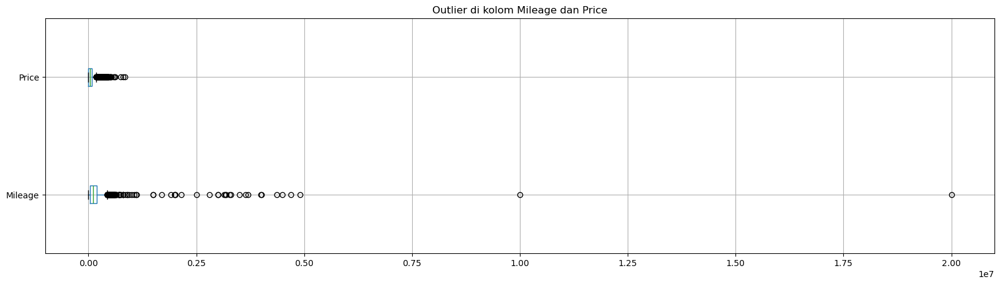

In [9]:
# Boxplot for check outliers
plt.figure(figsize=(20,5))
df[['Mileage','Price']].boxplot(vert=False)
plt.title('Outlier di kolom Mileage dan Price')
plt.show()

Bisa dilihat bahwa terdapat banyak sekali outlier di kolom Mileage dan Price, kita akan melakukan cleaning di setiap kolom. Cleaning dilakukan agar model Machine Learning bisa lebih akurat dan tidak bias terhadap outlier.

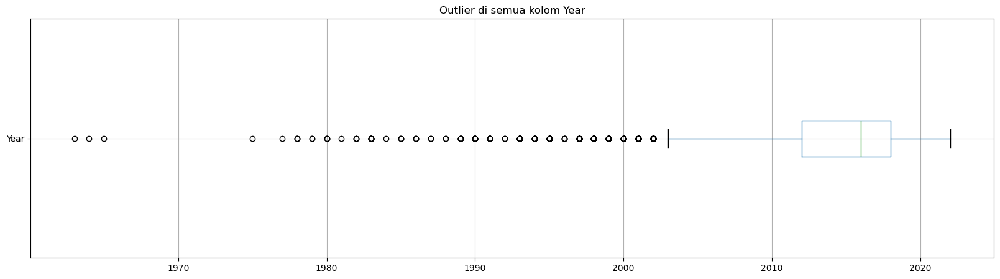

In [10]:
# Boxplot for check outliers
plt.figure(figsize=(20,5))
df[['Year']].boxplot(vert=False)
plt.title('Outlier di semua kolom Year')
plt.show()

Untuk kolom Year, terdapat banyak outlier kita akan mengecek dimana bisa dianggap sebagai outlier

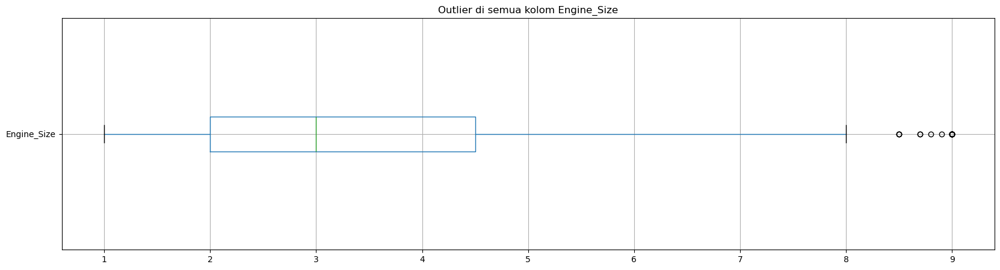

In [11]:
# Boxplot for check outliers
plt.figure(figsize=(20,5))
df[['Engine_Size']].boxplot(vert=False)
plt.title('Outlier di semua kolom Engine_Size')
plt.show()

Untuk kolom Engine_Size, terdapat banyak outlier tetapi kita masih bisa menggunakan data ini karena data Engine_Size ini diperlukan karena berkorelasi cukup kuat dan masih masuk akal.

# **1.Data Cleaning**

## a.Remove Negotiable True Row

Kita akan menghilangkan row dengan Negotiable True karena price 0 tidak relevan dengan prediksi harga.

In [12]:
df[df['Negotiable']==True].head(10)[['Negotiable','Price']]

,Negotiable,Price
0,True,0
4,True,0
9,True,0
14,True,0
15,True,0
16,True,0
19,True,0
22,True,0
27,True,0
33,True,0


In [13]:
print(f'''Jumlah data dengan Negotiable True : {len(df[df['Negotiable']==True])}''')

Jumlah data dengan Negotiable True : 1795


In [14]:
print(f'''Jumlah data yang dihapus : {len(df[df['Negotiable']==True])}''')
df.drop(df[df['Negotiable']==True].index,inplace=True)

Jumlah data yang dihapus : 1795


## b.Outlier pada Kolom Price

Kita akan mengecek jumlah outlier pada kolom Price

Setelah mengecek website, harga termurah yang dijual adalah SAR 25.000 dan di website lain 15.000. Jadi bisa diambil kesimpulan harga paling murah mobil di Arab adalah SAR 15.000, di bawah itu bisa disebut sebagai outlier.

Dan untuk batas atas kita akan mengambil Upper Bound yaitu SAR 182.500

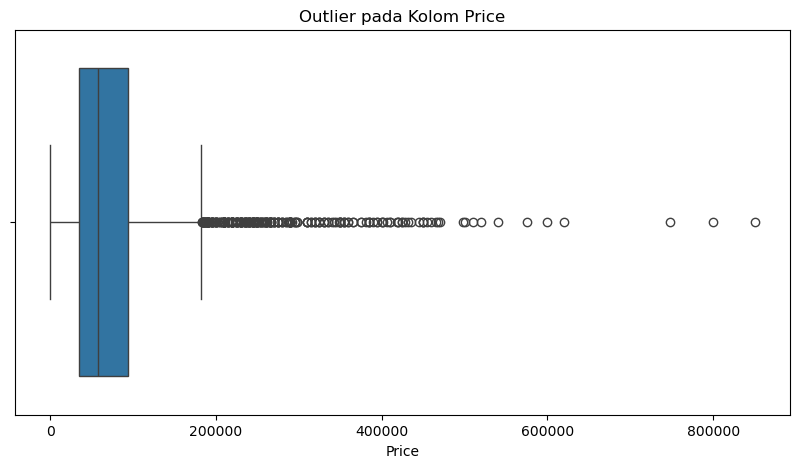

In [15]:
plt.figure(figsize=(10,5))
sns.boxplot(x=df['Price'])
plt.title('Outlier pada Kolom Price')
plt.show()

In [16]:
def quantiles(dataframe = df ,columns="Price"):
    Q1 = dataframe[columns].quantile(0.25)
    Q2 = dataframe[columns].quantile(0.5)
    Q3 = dataframe[columns].quantile(0.75)
    IQR = Q3 - Q1
    upper_bound = Q3 + IQR * 1.5 
    lower_bound = Q1 - IQR * 1.5
    return Q1,Q2,Q3,IQR,upper_bound,lower_bound

value = quantiles(dataframe=df,columns='Price')

print(f'''
Q1 = {value[0]}
Q2 = {value[1]}
Q3 = {value[2]}
IQR = {value[3]}
Upper Bound = {value[4]}
Lower Bound = {value[5]}
''')


print(f'''Jumlah data outlier di kolom harga terdapat {df[(df['Price']<15000) | (df['Price'] > value[4])]['Price'].count()} data dengan nilai outlier (Diatas Upper Bound {value[4]} & Harga mobil dibawah 15000)''')
df.drop(df[(df['Price']<15000) | (df['Price'] > value[4])].index,inplace=True)



Q1 = 35000.0
Q2 = 58000.0
Q3 = 94000.0
IQR = 59000.0
Upper Bound = 182500.0
Lower Bound = -53500.0

Jumlah data outlier di kolom harga terdapat 465 data dengan nilai outlier (Diatas Upper Bound 182500.0 & Harga mobil dibawah 15000)


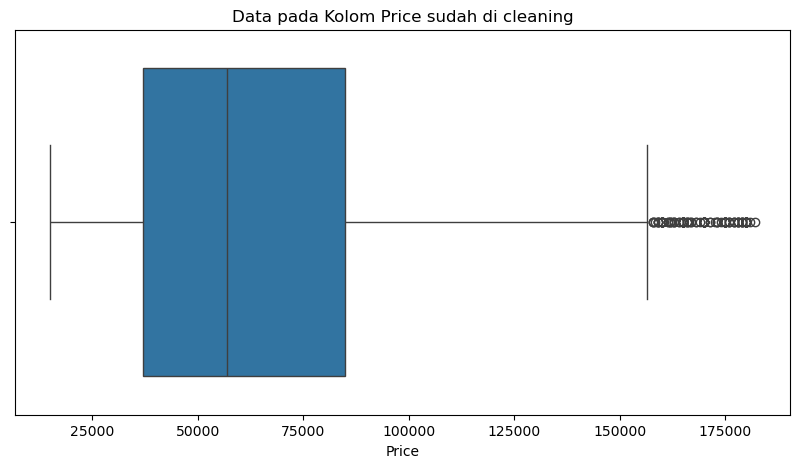

In [17]:
plt.figure(figsize=(10,5))
sns.boxplot(x=df['Price'])
plt.title('Data pada Kolom Price sudah di cleaning')
plt.show()

## c. Kolom Year
Kita akan melakukan cleaning untuk mengurangi outlier, bila dilihat jumlah data kita akan menghapus yang jumlah data di bawah 10 karena kurang menggambarkan group tersebut. Kita akan melimit di tahun 2003.

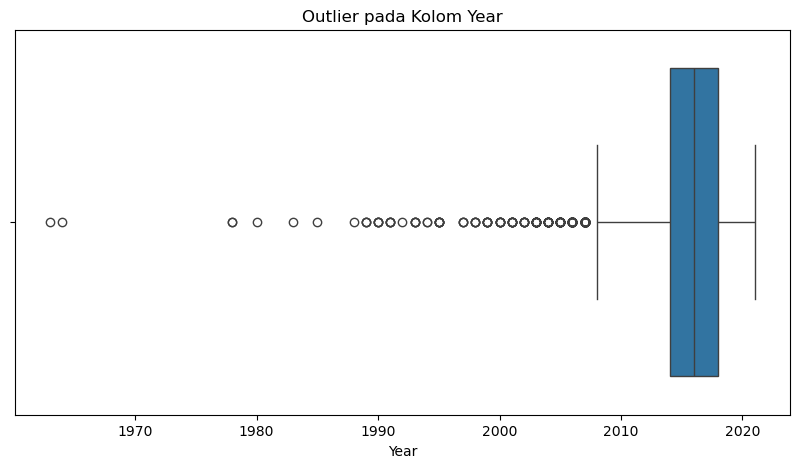

In [18]:
plt.figure(figsize=(10,5))
sns.boxplot(x=df['Year'])
plt.title('Outlier pada Kolom Year')
plt.show()

In [19]:
df['Year'].value_counts().reset_index().sort_values(by='Year',ascending=False).loc[lambda x: x['count'] < 10]

,Year,count
22,2002,6
19,2001,7
23,2000,6
20,1999,6
26,1998,4
28,1997,3
21,1995,6
31,1994,2
27,1993,4
37,1992,1


In [20]:
print(f'''Jumlah data outlier di kolom Year terdapat {df[df['Year']<2003]['Price'].count()}''')
df.drop(df[df['Year']<2003].index,inplace=True)

Jumlah data outlier di kolom Year terdapat 64


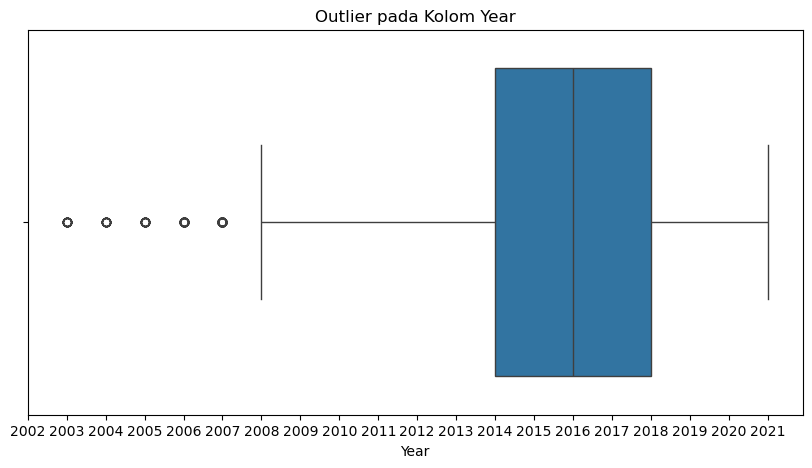

In [21]:
plt.figure(figsize=(10,5))
sns.boxplot(x=df['Year'])
plt.title('Outlier pada Kolom Year')
plt.xticks(ticks=range(2002, 2022), labels=range(2002, 2022))
plt.show()

## d.Outlier pada Kolom Mileage

Kita akan mengecek jumlah outlier pada kolom Mileage, maximum sebuah mobil yang masuk akal adalah 320 ribu KM ke atas. Jarak ini pun bisa dicapai bila mobil dimaintain dengan sangat baik. Untuk data ini Upper Boundnya adalah 376.000, bila dibandingkan dengan hasil research angka ini masih masuk akal. Oleh karena itu kita akan menggunakan nilai Upper Boundnya untuk cleaning.

Source : https://www.consumerreports.org/cars/car-reliability-owner-satisfaction/what-is-a-reasonable-life-span-for-a-modern-car-a4678774857/

In [22]:
value = quantiles(dataframe=df,columns='Mileage')

print(f'''
Q1 = {value[0]}
Q2 = {value[1]}
Q3 = {value[2]}
IQR = {value[3]}
Upper Bound = {value[4]}
Lower Bound = {value[5]}
''')


Q1 = 56000.0
Q2 = 108000.0
Q3 = 184000.0
IQR = 128000.0
Upper Bound = 376000.0
Lower Bound = -136000.0



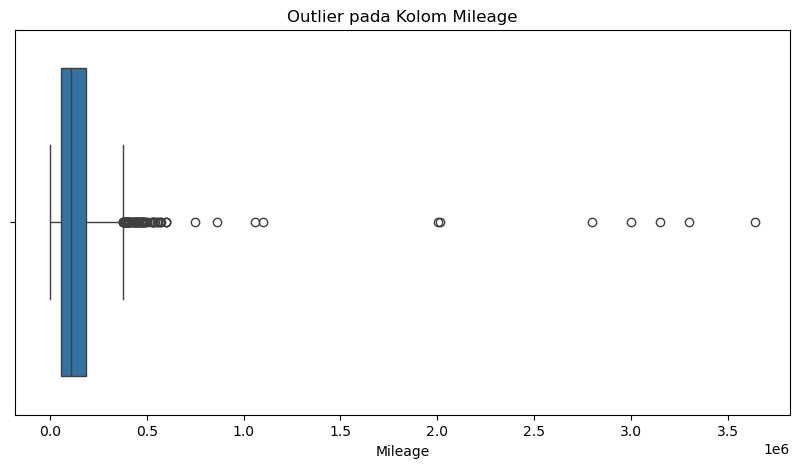

In [23]:
plt.figure(figsize=(10,5))
sns.boxplot(x=df['Mileage'])
plt.title('Outlier pada Kolom Mileage')
plt.show()

In [24]:
df[df['Mileage']>value[4]]

,Type,Region,Make,Gear_Type,Origin,Options,Year,Engine_Size,Mileage,Negotiable,Price
117,Furniture,Taef,Toyota,Manual,Saudi,Standard,2009,2.70,530500,False,33000
174,Durango,Yanbu,Dodge,Automatic,Saudi,Semi Full,2013,5.70,487100,False,35000
244,CX9,Riyadh,Mazda,Automatic,Saudi,Full,2014,3.70,388000,False,37000
258,Land Cruiser,Hail,Toyota,Manual,Gulf Arabic,Full,2013,1.00,378000,False,75000
333,Range Rover,Jeddah,Land Rover,Automatic,Saudi,Full,2009,2.40,2013000,False,35000
...,...,...,...,...,...,...,...,...,...,...,...
5425,Land Cruiser Pickup,Riyadh,Toyota,Manual,Saudi,Standard,2009,4.50,468000,False,65000
5543,Edge,Qassim,Ford,Automatic,Saudi,Full,2012,3.50,395000,False,35000
5554,Camry,Al-Medina,Toyota,Automatic,Saudi,Full,2007,2.50,420000,False,25000
5595,Land Cruiser,Dammam,Toyota,Manual,Saudi,Standard,2007,4.50,480000,False,65000


In [25]:
print(f'''Jumlah data yang dihapus : {df[df['Mileage']>value[4]].shape[0]}''')
df.drop(df[df['Mileage']>value[4]].index,inplace=True)

Jumlah data yang dihapus : 104


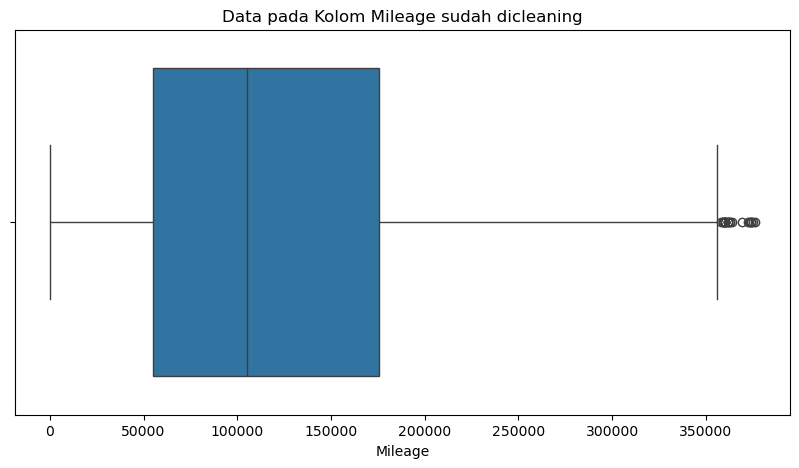

In [26]:
plt.figure(figsize=(10,5))
sns.boxplot(x=df['Mileage'])
plt.title('Data pada Kolom Mileage sudah dicleaning')
plt.show()

## e. Kolom Origin

Agar machine learning tidak mengeluarkan error, maka kolom dengan data Unknown harus dihandle dengan cara mengubah menjadi Missing

In [27]:
tabel1Desc.iloc[[4]]

,Column Name,Number of Unique,Unique Sample
4,Origin,4,"[Saudi, Gulf Arabic, Other, Unknown]"


In [28]:
df['Origin'].unique()

array(['Saudi', 'Gulf Arabic', 'Other', 'Unknown'], dtype=object)

In [29]:
df['Origin'].replace('Unknown', 'Missing',inplace=True)

/var/folders/dt/mp18g7bj3fs8hm27kth1hcvw0000gn/T/ipykernel_36827/3028395238.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Origin'].replace('Unknown', 'Missing',inplace=True)


## Clean Dataset

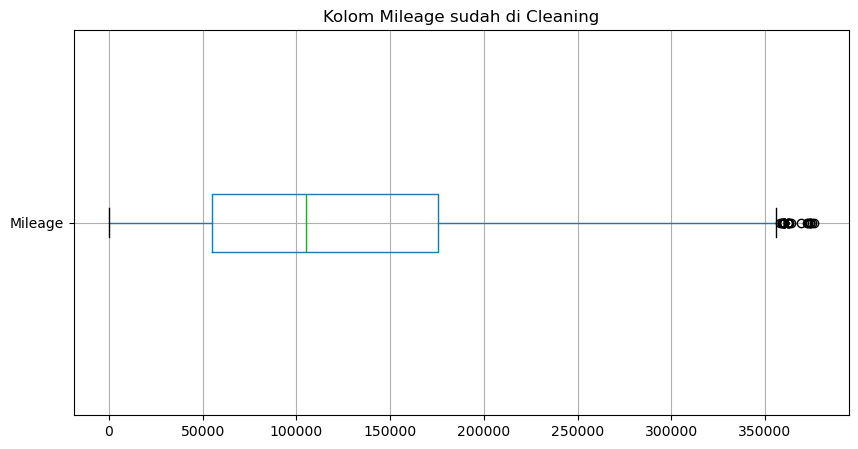

In [30]:
# Boxplot for check outliers
plt.figure(figsize=(10,5))
df[['Mileage']].boxplot(vert=False)
plt.title('Kolom Mileage sudah di Cleaning')
plt.show()

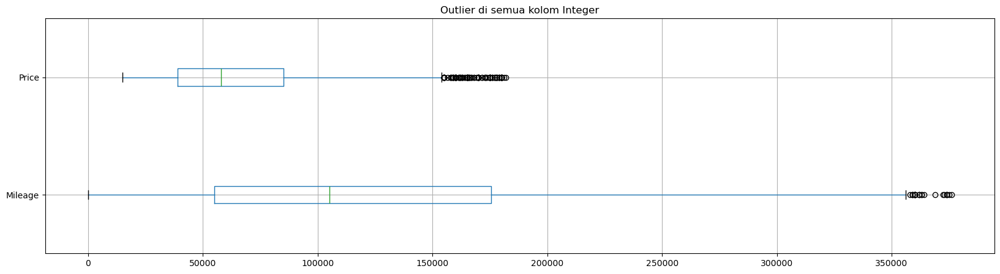

In [31]:
# Boxplot for check outliers
plt.figure(figsize=(20,5))
df[['Mileage','Price']].boxplot(vert=False)
plt.title('Outlier di semua kolom Integer')
plt.show()

In [32]:
shapeakhir =  df.shape

In [33]:
print(f'''
      Setelah melakukan cleaning, tersisa {shapeakhir[0]} baris data dari awal {shapeawal[0]} baris data yang akan digunakan untuk membuat model.
      Ini berarti terdapat {shapeawal[0]-shapeakhir[0]} baris data atau {round((shapeawal[0]-shapeakhir[0])/shapeawal[0]*100)}% data sudah tereliminasi sesuai dengan asumsi dan argumen yang disampaikan di proses-proses sebelumnya.
''')


      Setelah melakukan cleaning, tersisa 3192 baris data dari awal 5624 baris data yang akan digunakan untuk membuat model.
      Ini berarti terdapat 2432 baris data atau 43% data sudah tereliminasi sesuai dengan asumsi dan argumen yang disampaikan di proses-proses sebelumnya.



## Data Correlation

Kita akan melihat korelasi data antara satu kolom dengan kolom lainnya, data yang bisa dibuat korelasi adalah data integer. Sebelum bisa melakukan korelasi, kita harus mengecek distribusi data dulu.

In [34]:
from scipy.stats import shapiro

# Fill Ho and Ha First
Ho = "We assume Data is Normally Distributed" # Ho typically no difference, no effect, no relationship
Ha = "We assume Data is NOT Normally Distributed"

# Put Which function to use here
statistic,pvaluesw = shapiro(df['Price'])

#Conclusion
if pvaluesw >= 0.05:
    print(f'''
    pvalue = {pvaluesw}. pvalue >= 0.05. Fail to reject Ho. 
    {Ho}
    ''')
else:
    print(f'''
    pvalue = {pvaluesw}. pvalue < 0.05. Reject Ho. 
    {Ha}''')


    pvalue = 3.598203345227517e-39. pvalue < 0.05. Reject Ho. 
    We assume Data is NOT Normally Distributed


Karena data tidak terdistribusi normal kita akan menggunakan korelasi dengan metode spearman

<Axes: >

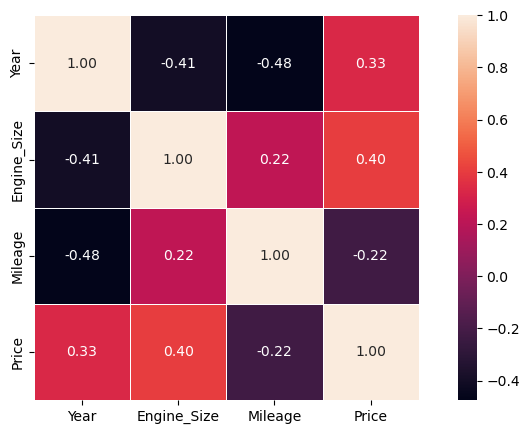

In [35]:
plt.figure(figsize=(10, 5))
list_column = []

for i in df.columns:
    if (df[i].dtype == "float64") | (df[i].dtype == 'int64'):
        list_column.append(i)

corr = df[list_column].corr(method='spearman')

sns.heatmap(corr, annot=True, fmt='.2f', square=True, linewidths=.5)


In [36]:
correlation = df['Price'].corr(df['Engine_Size'],method='spearman')

# conclusion
if correlation > 0:
    if 0 < correlation <= 0.2:
        print(f'''Correlation Score = {correlation}. very weak (tidak memiliki korelasi) | Direction : Positive''')
    elif 0.2 < correlation <= 0.4:
        print(f'''Correlation Score  = {correlation}. weak | Direction : Positive''')
    elif 0.4 < correlation <= 0.6:
        print(f'''Correlation Score  = {correlation}. moderate | Direction : Positive''')
    elif 0.6 < correlation <= 0.9:
        print(f'''Correlation Score  = {correlation}. strong | Direction : Positive''')
    elif correlation <= 1 :
        print(f'''Correlation Score  = {correlation}. very strong | Direction : Positive''')
else:
    if -0.2 <= correlation < 0:
        print(f'''Correlation Score = {correlation}. very weak (tidak memiliki korelasi) | Direction : Negative''')
    elif -0.4 <= correlation < -0.2:
        print(f'''Correlation Score  = {correlation}. weak | Direction : Negative''')
    elif -0.6 <= correlation <= -0.4:
        print(f'''Correlation Score  = {correlation}. moderate Direction : Negative''')
    elif -0.9 <= correlation <= 0.6:
        print(f'''Correlation Score  = {correlation}. strong | Direction : Negative''')
    elif correlation <= -1 :
        print(f'''Correlation Score  = {correlation}. very strong | Direction : Negative''')



Correlation Score  = 0.40451768268180277. moderate | Direction : Positive


Kesimpulan

Tidak ada kolom yang berkorelasi kuat dengan Kolom Price, korelasi kolom paling tinggi ada di Engine_Size. Ini berarti semakin tinggal Engine_Size semakin tinggi harga mobil tersebut

# 2.EDA (Exploratory Data Analysis)

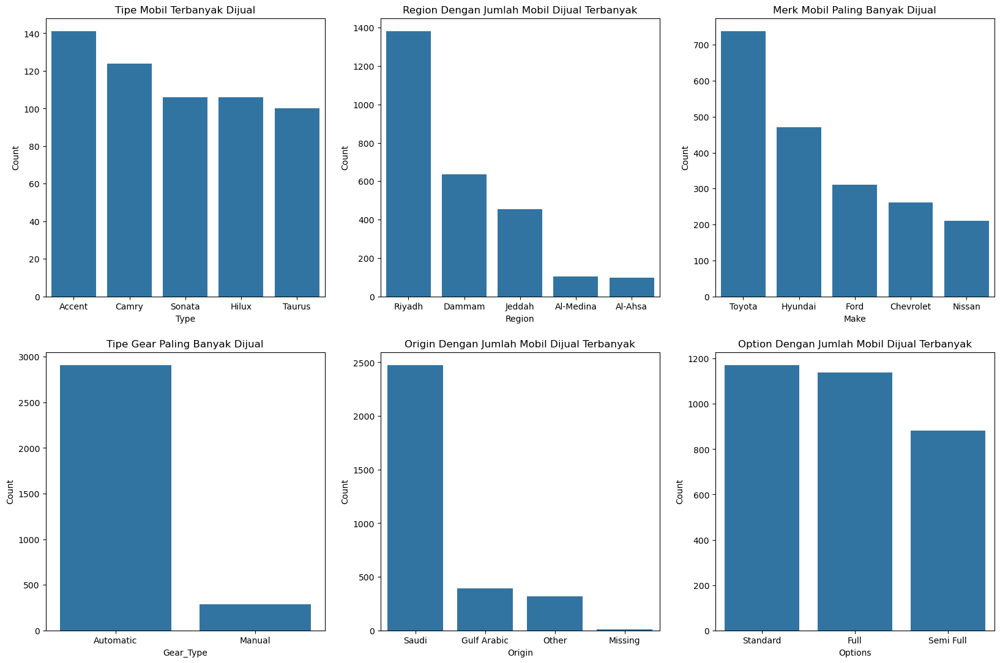

In [37]:
fig, ax = plt.subplots(2,3,figsize=(20,13))


sns.barplot(df.groupby('Type')['Region'].count().sort_values(ascending=False).head(), ax=ax[0,0])
ax[0,0].set_ylabel('Count')  # Rename y-label for subplot 1
ax[0,0].set_title('Tipe Mobil Terbanyak Dijual')


sns.barplot(df.groupby('Region')['Region'].count().sort_values(ascending=False).head(), ax=ax[0,1])
ax[0,1].set_ylabel('Count')  # Rename y-label for subplot 1
ax[0,1].set_title('Region Dengan Jumlah Mobil Dijual Terbanyak')

sns.barplot(df.groupby('Make')['Region'].count().sort_values(ascending=False).head(), ax=ax[0,2])
ax[0,2].set_ylabel('Count')  # Rename y-label for subplot 1
ax[0,2].set_title('Merk Mobil Paling Banyak Dijual')

sns.barplot(df.groupby('Gear_Type')['Region'].count().sort_values(ascending=False), ax=ax[1,0])
ax[1,0].set_ylabel('Count')  # Rename y-label for subplot 1
ax[1,0].set_title('Tipe Gear Paling Banyak Dijual')

sns.barplot(df.groupby('Origin')['Region'].count().sort_values(ascending=False), ax=ax[1,1])
ax[1,1].set_ylabel('Count')  # Rename y-label for subplot 1
ax[1,1].set_title('Origin Dengan Jumlah Mobil Dijual Terbanyak')

sns.barplot(df.groupby('Options')['Region'].count().sort_values(ascending=False), ax=ax[1,2])
ax[1,2].set_ylabel('Count')  # Rename y-label for subplot 1
ax[1,2].set_title('Option Dengan Jumlah Mobil Dijual Terbanyak')

plt.show()


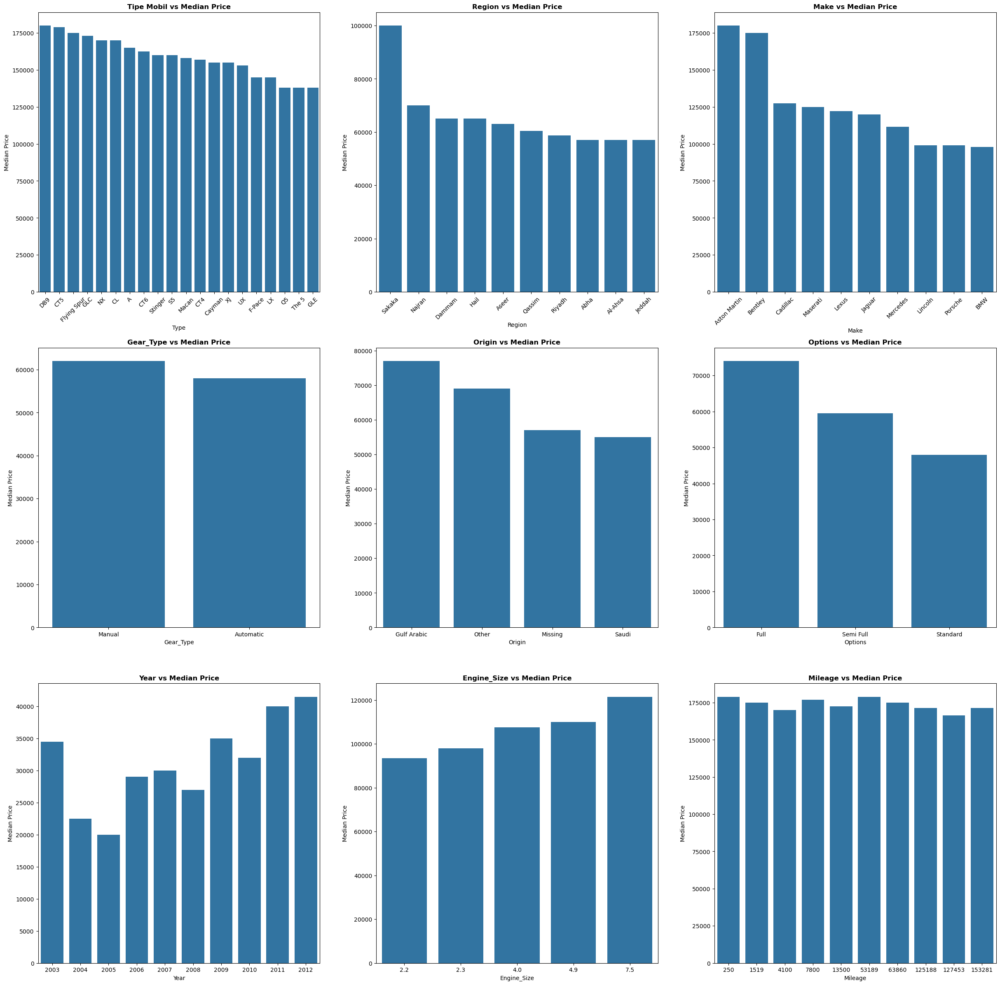

In [38]:
fig, ax = plt.subplots(3,3,figsize=(30,30))

sns.barplot(df.groupby('Type')['Price'].median().sort_values(ascending=False).head(20),ax=ax[0,0])
ax[0,0].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[0,0].set_title('Tipe Mobil vs Median Price', fontweight='heavy')
ax[0, 0].tick_params(axis='x', rotation=45)

sns.barplot(df.groupby('Region')['Price'].median().sort_values(ascending=False).head(10),ax=ax[0,1])
ax[0,1].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[0,1].set_title('Region vs Median Price', fontweight='heavy')
ax[0, 1].tick_params(axis='x', rotation=45)

sns.barplot(df.groupby('Make')['Price'].median().sort_values(ascending=False).head(10),ax=ax[0,2])
ax[0,2].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[0,2].set_title('Make vs Median Price', fontweight='heavy')
ax[0,2].tick_params(axis='x', rotation=45)

sns.barplot(df.groupby('Gear_Type')['Price'].median().sort_values(ascending=False),ax=ax[1,0])
ax[1,0].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[1,0].set_title('Gear_Type vs Median Price', fontweight='heavy')
ax[1,0].tick_params(axis='x')

sns.barplot(df.groupby('Origin')['Price'].median().sort_values(ascending=False),ax=ax[1,1])
ax[1,1].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[1,1].set_title('Origin vs Median Price', fontweight='heavy')
ax[1,1].tick_params(axis='x')

sns.barplot(df.groupby('Options')['Price'].median().sort_values(ascending=False),ax=ax[1,2])
ax[1,2].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[1,2].set_title('Options vs Median Price', fontweight='heavy')
ax[1,2].tick_params(axis='x')

sns.barplot(data=df.groupby('Year')['Price'].median().reset_index().sort_values(by='Year').head(10),x='Year',y='Price',ax=ax[2,0])
ax[2,0].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[2,0].set_title('Year vs Median Price', fontweight='heavy')
ax[2,0].tick_params(axis='x')

sns.barplot(df.groupby('Engine_Size')['Price'].median().sort_values(ascending=False).head(),ax=ax[2,1])
ax[2,1].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[2,1].set_title('Engine_Size vs Median Price', fontweight='heavy')
ax[2,1].tick_params(axis='x')

sns.barplot(df.groupby('Mileage')['Price'].median().sort_values(ascending=False).head(10),ax=ax[2,2])
ax[2,2].set_ylabel('Median Price')  # Rename y-label for subplot 1
ax[2,2].set_title('Mileage vs Median Price', fontweight='heavy')
ax[2,2].tick_params(axis='x')

Bisa dilihat dari grafik diatas bahwa semua kolom kategorical mempengaruhi rata - rata `Price`, jadi bisa disimpulkan bahwa semua kolom dapat digunakan untuk membuat modeling karena mempengaruhi rata - rata `Price`

In [39]:
# import library untuk 2 sample
from scipy.stats import mannwhitneyu

# Fill Ho and Ha First
Ho = "Median Gear_Type Manual = Median Gear_Type Automatic" # Ho typically no difference, no effect, no relationship
Ha = "Median Gear_Type Manual ≠ Median Gear_Type Automatic'"

# Put Which function to use here
stat, pvaluemw = mannwhitneyu(
    df[df['Gear_Type']=='Manual']['Price'],
    df[df['Gear_Type']=='Automatic']['Price']    
)

pvaluemw

# alternative = 'two-sided' --> karena yang dibandingkan berupa two tail (2 arah)

#Conclusion
if pvaluemw >= 0.05:
    print(f'''
    pvalue = {pvaluemw}. pvalue >= 0.05. Fail to reject Ho. 
    Kita TIDAK punya cukup bukti bahwa rata - rata {Ha}
    (Rata-rata antara kedua data tidak terdapat perbedaan signinfikan)
    ''')
else:
    print(f'''
    pvalue = {pvaluemw}. pvalue < 0.05. Reject Ho. 
    Kita punya cukup bukti bahwa rata - rata {Ha}
    (Rata-rata antara kedua data terdapat perbedaan signinfikan)
    ''')


    pvalue = 0.3061719444056996. pvalue >= 0.05. Fail to reject Ho. 
    Kita TIDAK punya cukup bukti bahwa rata - rata Median Gear_Type Manual ≠ Median Gear_Type Automatic'
    (Rata-rata antara kedua data tidak terdapat perbedaan signinfikan)
    


Karena di grafik Gear_Type vs Median Price cukup sedikit selisihnya, kita bisa menggunakan Manwhitney untuk mengecek apakah ada perbedaan signifikan dan hasilnya **ada perbedaan signifikan**

# 3.Define X dan y

Untuk menggunakan Machine Learning, kita perlu memisahkan Feature dan Target. 

* Feature adalah independent variabel yang menjelaskan sebuah data yang tidak terpengaruh dengan column lainnya, untuk di kasus ini menjelaskan spesifikasi dari mobil bekas.Feature yang akan digunakan adalah Type, Region, Make, Gear Type, Origin, Options, Year, Engine Size, dan Mileage. Semua Feature akan dimasukan ke variabel X

* Target adalah dependent variabel yang terpengaruh dengan column lainnya, untuk dikasus ini adalah Price. Target akan dimasukan ke variabel y

In [40]:
X = df[['Type','Region','Make','Gear_Type','Origin','Options','Year','Engine_Size','Mileage']]
y = df['Price']

# 4. Data Splitting

Di sini kita akan melakukan splitting data, ini bertujuan untuk diakhir kita dapat mengecek prediksi dari machine learning seberapa jauh errornya.

Rasio nya adalah data training 80% dan testnya 20%, angka ini dipilih karena umum digunakan

Random state diset di 0 agar hasil splitting konsisten.

In [41]:
X_train, X_test, y_train, y_test = train_test_split(
X,
y,test_size=0.2,
random_state=0
)

# 5.Preprocessing

Di dalam Machine Learning, kita perlu untuk melakukan preprocessing. Preprocessing adalah tahap mengubah data - data di dataset menjadi numerical, hal ini dilakukan karena Model tidak bisa menggunakan data categorical. Dikarenakan dataset ini mengandung categorical dan numerical dengan scala yang cukup berbeda beda, maka kita akan melakukan preprocessing dengan cara yang berbeda beda.

Kita akan menggunakan ColumnTransformer dengan spesifikasi sebagai berikut :

Ordinal : ['Option']
- option (Full 3, Semi full 2, Standard 1)
    - Alasan : Option menggambarkan kelengkapan fitur, semakin lengkap akan semakin baik sehingga dimasukan ke Ordinal atau memiliki tingkatan

Binary Encoding (>5) : ['Type','Region','Make']
- type : dari 347 unique menjadi 9 kolom
- region : dari 27 unique menjadi 5 kolom
- Make : dari 58 unique menjadi 6 kolom
    - Alasan : type, region, dan make memiliki variasi data yang sangat banyak atau di atas 10, oleh karena itu menggunakan binary encoding agar mengurangi jumlah fitur. (Binary mengubah categorical menjadi angka binary 01)


One-Hot : ['Gear_Type','Origin']
- Geartype : 2 variasi
- Origin : 6 variasi
    - Alasan : Geartype dan Origin memiliki jumlah variasi dibawah 10, sehingga masih bisa menggunakan one hot yaitu mengubah tiap variasi menjadi fitur


Robust : ['Mileage','Engine_Size','Year']
- mileage
- Engine size
- Year
    - Alasan : Untuk kolom mileage, engine size, dan year akan menggunakan robustscale dengan cara mengurangi tiap data dikurangi median lalu dibagi IQR. Robust Scaller paling aman ketika dataset memiliki outlier.

In [42]:
ordinal_encoding = [{ #ranking makin gede angkanya makin bagus
'col': 'Options',
'mapping' : {'Standard':1,
             'Semi Full': 2,
             'Full' : 3
             }
}]

In [43]:
pipe_ordinal_robust = Pipeline([
    ('ordinal',OrdinalEncoder(mapping=ordinal_encoding)),
    ('robust',RobustScaler())
])

In [44]:
transformer = ColumnTransformer([
    ('pipe_ordinal_robust',pipe_ordinal_robust,['Options']),
    ('Binary',BinaryEncoder(),['Type','Region','Make']),
    ('robust',RobustScaler(),['Mileage','Engine_Size','Year']),
    ('onehot',OneHotEncoder(handle_unknown='ignore'),['Gear_Type','Origin'])
], remainder='passthrough')

# 6. Cross Validation

Model yang akan digunakan adalah jenis Regressi dikarenakan kita akan memprediksi sebuah harga yang merupakan data jenis continuous. di bawah ini adalah beberapa model yang cocok digunakan untuk Regresi.

Model yang akan digunakan adalah :
- KNeighbors Regressor
- DecisionTree Regressor
- Linear Regression
- XGB Regressor
- Stacking (Linear, Decision Tree, KNN, dan XGB)
- Catbooster Regressor

Ditahap ini kita akan menguji model mana yang paling terbaik untuk dataset. Dilihat dari nilai RMSE, MAE, MAPE dan R2 terbaik.

In [45]:
#define algo

# define algorithm
knn = KNeighborsRegressor(n_neighbors=5)
tree = DecisionTreeRegressor(random_state=42)
lr = LinearRegression()
xgb = XGBRegressor(random_state=42)
stacking = StackingRegressor(estimators=[
    ('clf1',lr),
    ('clf2',tree),
    ('clf3',knn)],
    final_estimator=xgb)
cb = CatBoostRegressor(random_seed=42)

list_mean_rmse = []
list_std_rmse = []

list_mean_mae = []
list_std_mae = []

list_mean_mape = []
list_std_mape = []

list_mean_r2 = []
list_std_r2 = []

list_algo = [knn,tree,lr,xgb,stacking,cb]
list_algo_name = ['KNeighborsRegressor','DecisionTreeRegressor','LinearRegression','XGBRegressor','StackingRegressor','CatBooster']

scorer = ['neg_root_mean_squared_error',
          'neg_mean_absolute_percentage_error',
          'neg_mean_absolute_error','r2']


for algo in list_algo:
    model = algo
    # pipeline
    pipe  = Pipeline([
        ('scaling', transformer),
        ('modeling', model)
    ])

    # cross validation
    cv_score = cross_validate(
        estimator=pipe,
        X = X_train,
        y = y_train,
        cv = 5,
        scoring = scorer
    )
    list_mean_rmse.append(-1*cv_score['test_neg_root_mean_squared_error'].mean())
    list_std_rmse.append(-1*cv_score['test_neg_root_mean_squared_error'].std())
    list_mean_mae.append(-1*cv_score['test_neg_mean_absolute_error'].mean())
    list_std_mae.append(-1*cv_score['test_neg_mean_absolute_error'].std())
    list_mean_mape.append(-1*cv_score['test_neg_mean_absolute_percentage_error'].mean())
    list_std_mape.append(-1*cv_score['test_neg_mean_absolute_percentage_error'].std())
    list_mean_r2.append(cv_score['test_r2'].mean())
    list_std_r2.append(cv_score['test_r2'].std())

Learning rate set to 0.045832
0:	learn: 37510.3334495	total: 59.8ms	remaining: 59.7s
1:	learn: 36749.9050389	total: 61.4ms	remaining: 30.7s
2:	learn: 36041.0598732	total: 63ms	remaining: 20.9s
3:	learn: 35294.0979252	total: 66.4ms	remaining: 16.5s
4:	learn: 34656.0077345	total: 67.4ms	remaining: 13.4s
5:	learn: 33961.7022861	total: 68.8ms	remaining: 11.4s
6:	learn: 33337.1442769	total: 70ms	remaining: 9.93s
7:	learn: 32797.0470309	total: 71.6ms	remaining: 8.88s
8:	learn: 32217.2139740	total: 73ms	remaining: 8.03s
9:	learn: 31681.4895877	total: 74.5ms	remaining: 7.38s
10:	learn: 31194.9192303	total: 76.3ms	remaining: 6.86s
11:	learn: 30665.1342400	total: 77.4ms	remaining: 6.37s
12:	learn: 30291.7988720	total: 78.8ms	remaining: 5.98s
13:	learn: 29833.1618860	total: 81ms	remaining: 5.71s
14:	learn: 29429.7918289	total: 82.3ms	remaining: 5.41s
15:	learn: 28985.3567948	total: 83.9ms	remaining: 5.16s
16:	learn: 28524.4713045	total: 85.5ms	remaining: 4.95s
17:	learn: 28151.3170506	total: 88.4

In [46]:
df_cv = pd.DataFrame()
df_cv['algo'] = list_algo_name

df_cv['mean_RMSE'] = list_mean_rmse
df_cv['std_RMSE'] = list_std_rmse

df_cv['mean_MAE'] = list_mean_mae
df_cv['std_MAE'] = list_std_mae

df_cv['mean_MAPE'] = list_mean_mape
df_cv['std_MAPE'] = list_std_mape

df_cv['mean_R2'] = list_mean_r2
df_cv['std_R2'] = list_std_r2


df_cv.sort_values(by='mean_RMSE')

,algo,mean_RMSE,std_RMSE,mean_MAE,std_MAE,mean_MAPE,std_MAPE,mean_R2,std_R2
5,CatBooster,15783.61,-645.32,10382.90,-164.53,0.18,-0.01,0.83,0.02
3,XGBRegressor,17736.17,-973.88,11790.06,-400.92,0.21,-0.01,0.79,0.02
0,KNeighborsRegressor,21181.91,-1066.43,14451.93,-632.54,0.27,-0.02,0.69,0.03
4,StackingRegressor,22429.57,-1275.15,14853.12,-506.62,0.25,-0.02,0.66,0.05
2,LinearRegression,26090.79,-702.35,19457.49,-486.58,0.36,-0.02,0.54,0.03
1,DecisionTreeRegressor,26468.56,-1394.92,16727.30,-704.18,0.28,-0.02,0.52,0.06


Bila dilihat dari hasil nilai MAE, MAPE, RMSE dan R2, terdapat nilai yang berbeda cukup signifikan dan bahkan hampir 50%. Hal ini terjadi karena nulau RMSE nilai errornya dikuadratkan dulu sebelum dirata - ratakan. Hal ini menyebabkan RMSE akan memberikan 'weight' yang lebih tinggi untuk nilai error yang besar.


- Berdasarkan nilai MAE, MAPE, RMSE dan R2, CatBooster adalah model terbaik.
- Selanjutnya, akan dilakukan prediksi pada test set dengan benchmark 3 model terbaik, yaitu CatBooster,XGBoostRegressor, dan KNeighborsRegressor

In [47]:
# Benchmark 2 model terbaik
models = {
    'CatBooster' : CatBoostRegressor(random_seed=42,used_ram_limit="4GB"),
    'XGBRegressor': XGBRegressor(random_state=42),
    'KNeighborsRegressor': KNeighborsRegressor(n_neighbors=5),
}

list_mean_rmse = []
list_mean_mae = []
list_mean_mape = []
list_mean_r2 = []

# Prediksi pada test set
for i in models:

    model = Pipeline([
        ('preprocessing', transformer),
        ('model', models[i])
        ])

    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    list_mean_rmse.append(np.sqrt(mean_squared_error(y_test, y_pred)))
    list_mean_mae.append(mean_absolute_error(y_test, y_pred))
    list_mean_mape.append(mean_absolute_percentage_error(y_test, y_pred))
    list_mean_r2.append(r2_score(y_test, y_pred))

score_before_tuning = pd.DataFrame({'RMSE': list_mean_rmse, 'MAE': list_mean_mae, 'MAPE': list_mean_mape,'R2': list_mean_r2}, index=models.keys())
score_before_tuning.sort_values('MAE')

Learning rate set to 0.047478
0:	learn: 37522.2318203	total: 1.32ms	remaining: 1.32s
1:	learn: 36671.7528314	total: 2.44ms	remaining: 1.22s
2:	learn: 35888.1749472	total: 3.54ms	remaining: 1.18s
3:	learn: 35159.0458877	total: 4.55ms	remaining: 1.13s
4:	learn: 34431.5609501	total: 5.79ms	remaining: 1.15s
5:	learn: 33832.2988294	total: 6.89ms	remaining: 1.14s
6:	learn: 33214.6001685	total: 7.9ms	remaining: 1.12s
7:	learn: 32683.3776442	total: 8.91ms	remaining: 1.1s
8:	learn: 32100.8015506	total: 10ms	remaining: 1.1s
9:	learn: 31559.4097804	total: 11ms	remaining: 1.09s
10:	learn: 30983.4698615	total: 12.3ms	remaining: 1.1s
11:	learn: 30455.8266402	total: 13.4ms	remaining: 1.1s
12:	learn: 30003.3046219	total: 14.4ms	remaining: 1.09s
13:	learn: 29538.4082190	total: 15.5ms	remaining: 1.09s
14:	learn: 29128.5125173	total: 16.9ms	remaining: 1.11s
15:	learn: 28723.8346760	total: 18ms	remaining: 1.11s
16:	learn: 28321.0598881	total: 19.2ms	remaining: 1.11s
17:	learn: 27950.6294154	total: 20.2ms	

,RMSE,MAE,MAPE,R2
CatBooster,14950.45,10336.58,0.19,0.83
XGBRegressor,17137.53,12027.09,0.22,0.78
KNeighborsRegressor,20680.46,14374.42,0.27,0.68


- Ketika dilakukan prediksi pada test set, performa CatBooster secara akumulatif sedikit lebih baik. Hal ini dapat dilihat dari nilai RMSE dan MAE yang cukup lebih rendah dari XGBRegressor dan Kneighbors.

# 7.Hyperparameter

Karena CatBooster memiliki peforma yang paling baik, maka kita akan menggunakan model ini. Selanjutnya kita akan menggunakan Hyperparameter Tuning yaitu mencoba mencari pengaturan terbaik didalam model ini. Berikut adalah penjelasan dari paramater yang biasa digunakan untuk tuning :

| **Parameter** | **Penjelasan** | **Default Value** | **Efek** |
| --- | --- | --- | --- |
| iterations | 	Jumlah iterasi boosting (pohon) yang akan dibangun. Setiap iterasi menambahkan pohon baru untuk mengurangi kesalahan. | 1000 | Iterasi lebih banyak dapat meningkatkan akurasi tetapi juga meningkatkan waktu pelatihan dan risiko overfitting. |
| learning_rate | Ukuran langkah untuk memperbarui selama optimasi. Nilai lebih kecil membuat pelatihan lebih lambat tetapi lebih stabil.	 | 0.03 | Nilai rendah meningkatkan generalisasi tetapi membutuhkan lebih banyak iterasi; nilai tinggi mempercepat pelatihan tetapi bisa overfit. |
| depth | Kedalaman maksimum setiap pohon, menentukan jumlah pemisahan per pohon. | 6 | Pohon yang lebih dalam menangkap pola kompleks tetapi rentan terhadap overfitting; pohon yang lebih dangkal lebih sederhana. |
| l2_leaf_reg | Parameter regulasi L2 untuk nilai daun, mengontrol kompleksitas model. |  3 | Nilai lebih tinggi mengurangi overfitting dengan memberi penalti pada nilai daun besar; nilai lebih rendah lebih fleksibel tetapi bisa overfit. |
| bagging_temperature | Mengontrol tingkat randomisasi dalam pengambilan sampel selama pelatihan. Nilai lebih tinggi meningkatkan keragaman pohon. | 1 | Nilai tinggi mengurangi overfitting dengan meningkatkan randomisasi; nilai rendah membuat pohon lebih deterministik.|
| boosting_type |Jenis metode boosting yang digunakan. | Plain | Plain: Lebih cepat tetapi cenderung overfit. Ordered: Lebih lambat tetapi lebih tahan terhadap overfitting dengan statistik terurut.|
| grow_policy | Strategi untuk menumbuhkan pohon selama pelatihan | SymmetricTree | SymmetricTree: Menumbuhkan pohon secara simetris untuk kecepatan. Depthwise: Menambahkan kedalaman pohon secara merata. Lossguide: Berfokus pada pemisahan dengan pengurangan kerugian terbesar. |

In [48]:
%%time

# hyperparameter tuning untuk model XGBoost
model = CatBoostRegressor(random_seed=42,used_ram_limit="8GB")


# rus = RandomUnderSampler(random_state=0)
# ros = RandomOverSampler(random_state=0)
# smote = SMOTE(random_state=0,sampling_strategy='minority')
# nearmiss = NearMiss(sampling_strategy='majority')

hyperparam = {
    'modeling__iterations': [500, 1000, 2000],
    'modeling__learning_rate': [0.01, 0.05, 0.1],
    'modeling__depth': [4, 6, 8],
    'modeling__l2_leaf_reg': [1, 3, 5, 10],
    'modeling__bagging_temperature' : [0.5, 1.0, 2.0],
    'modeling__boosting_type' : ['Plain', 'Ordered'],
    'modeling__grow_policy' : ['SymmetricTree', 'Depthwise', 'Lossguide'],
    # 'resampling' : [None,rus,ros,smote,nearmiss]

}

Pipe_model = Pipeline([
    ('preprocessing',transformer),
    ('modeling', model)
    ])

scorer = ['neg_root_mean_squared_error',
          'neg_mean_absolute_percentage_error',
          'neg_mean_absolute_error','r2']

# define gridsearch
gridsearch = GridSearchCV(
    estimator = Pipe_model,
    cv = 5,
    scoring = scorer,
    refit='neg_mean_absolute_error',
    n_jobs= -1,
    param_grid= hyperparam   
)

randomsearch = RandomizedSearchCV(
    estimator = Pipe_model,
    param_distributions = hyperparam,
    n_jobs = -1,
    cv = 5,
    scoring = scorer,
    refit='neg_mean_absolute_error',
    n_iter = 100,
    random_state=0
)

randomsearch

CPU times: user 287 µs, sys: 234 µs, total: 521 µs
Wall time: 88.2 µs


RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessing',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('pipe_ordinal_robust',
                                                                               Pipeline(steps=[('ordinal',
                                                                                                OrdinalEncoder(mapping=[{'col': 'Options',
                                                                                                                         'data_type': dtype('O'),
                                                                                                                         'mapping': Standard     1
Semi Full    2
Full         3
dtype: int64}])),
                                                                                               ('robust',
                                                                                                RobustScaler())]),
                                                                               ['Options']),
                                                                              ('Binary',
                                                                               BinaryEncoder...
                                        'modeling__depth': [4, 6, 8],
                                        'modeling__grow_policy': ['SymmetricTree',
                                                                  'Depthwise',
                                                                  'Lossguide'],
                                        'modeling__iterations': [500, 1000,
                                                                 2000],
                                        'modeling__l2_leaf_reg': [1, 3, 5, 10],
                                        'modeling__learning_rate': [0.01, 0.05,
                                                                    0.1]},
                   random_state=0, refit='neg_mean_absolute_error',
                   scoring=['neg_root_mean_squared_error',
                            'neg_mean_absolute_percentage_error',
                            'neg_mean_absolute_error', 'r2'])

In [49]:
%%time
randomsearch.fit(X_train,y_train)

0:	learn: 38164.3987818	total: 53.3ms	remaining: 53.3s
1:	learn: 38014.7799305	total: 53.9ms	remaining: 26.9s
2:	learn: 37876.0551029	total: 54.8ms	remaining: 18.2s
0:	learn: 38172.4107553	total: 55.1ms	remaining: 55.1s
1:	learn: 38019.3394339	total: 56ms	remaining: 27.9s
3:	learn: 37729.9850476	total: 56.4ms	remaining: 14s
2:	learn: 37870.3540121	total: 57.1ms	remaining: 19s
4:	learn: 37575.9859854	total: 57.6ms	remaining: 11.5s
3:	learn: 37727.0436756	total: 57.6ms	remaining: 14.4s
5:	learn: 37429.1744223	total: 58.2ms	remaining: 9.64s
4:	learn: 37572.3614163	total: 58.5ms	remaining: 11.6s
6:	learn: 37292.3812222	total: 58.8ms	remaining: 8.34s
5:	learn: 37415.3367288	total: 59ms	remaining: 9.77s
7:	learn: 37134.4846093	total: 59.4ms	remaining: 7.36s
6:	learn: 37269.0236763	total: 59.8ms	remaining: 8.48s
8:	learn: 36985.8694271	total: 60.3ms	remaining: 6.63s
7:	learn: 37102.6462217	total: 60.4ms	remaining: 7.49s
9:	learn: 36850.6395440	total: 60.8ms	remaining: 6.02s
8:	learn: 36960.51

/opt/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
160 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
160 fits failed with the following error:
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.12/site-packages/sklearn/base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/lib/python3.12/site-packages/imblearn/pipeline.py", line 333, in fit
    self._final_estim

0:	learn: 37383.9173715	total: 4.57ms	remaining: 4.57s
1:	learn: 36423.3362717	total: 7.42ms	remaining: 3.7s
2:	learn: 35554.4020693	total: 10.4ms	remaining: 3.46s
3:	learn: 34688.4199737	total: 13.2ms	remaining: 3.29s
4:	learn: 33828.3420568	total: 16ms	remaining: 3.18s
5:	learn: 33002.9473787	total: 18.8ms	remaining: 3.12s
6:	learn: 32235.7591483	total: 21.6ms	remaining: 3.07s
7:	learn: 31415.8019088	total: 24.4ms	remaining: 3.03s
8:	learn: 30704.6951377	total: 27.3ms	remaining: 3.01s
9:	learn: 30112.6422879	total: 31ms	remaining: 3.06s
10:	learn: 29527.0653440	total: 33.9ms	remaining: 3.05s
11:	learn: 28960.3021121	total: 37ms	remaining: 3.04s
12:	learn: 28436.6328162	total: 39.8ms	remaining: 3.02s
13:	learn: 27803.3741207	total: 42.7ms	remaining: 3.01s
14:	learn: 27285.2694494	total: 45.6ms	remaining: 2.99s
15:	learn: 26846.5604209	total: 48.3ms	remaining: 2.97s
16:	learn: 26392.0118517	total: 51.2ms	remaining: 2.96s
17:	learn: 25960.5254238	total: 54ms	remaining: 2.94s
18:	learn: 

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessing',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('pipe_ordinal_robust',
                                                                               Pipeline(steps=[('ordinal',
                                                                                                OrdinalEncoder(mapping=[{'col': 'Options',
                                                                                                                         'data_type': dtype('O'),
                                                                                                                         'mapping': Standard     1
Semi Full    2
Full         3
dtype: int64}])),
                                                                                               ('robust',
                                                                                                RobustScaler())]),
                                                                               ['Options']),
                                                                              ('Binary',
                                                                               BinaryEncoder...
                                        'modeling__depth': [4, 6, 8],
                                        'modeling__grow_policy': ['SymmetricTree',
                                                                  'Depthwise',
                                                                  'Lossguide'],
                                        'modeling__iterations': [500, 1000,
                                                                 2000],
                                        'modeling__l2_leaf_reg': [1, 3, 5, 10],
                                        'modeling__learning_rate': [0.01, 0.05,
                                                                    0.1]},
                   random_state=0, refit='neg_mean_absolute_error',
                   scoring=['neg_root_mean_squared_error',
                            'neg_mean_absolute_percentage_error',
                            'neg_mean_absolute_error', 'r2'])

In [50]:
pd.DataFrame(randomsearch.cv_results_).sort_values(by='rank_test_neg_mean_absolute_error')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_modeling__learning_rate,param_modeling__l2_leaf_reg,param_modeling__iterations,param_modeling__grow_policy,param_modeling__depth,param_modeling__boosting_type,param_modeling__bagging_temperature,params,split0_test_neg_root_mean_squared_error,split1_test_neg_root_mean_squared_error,split2_test_neg_root_mean_squared_error,split3_test_neg_root_mean_squared_error,split4_test_neg_root_mean_squared_error,mean_test_neg_root_mean_squared_error,std_test_neg_root_mean_squared_error,rank_test_neg_root_mean_squared_error,split0_test_neg_mean_absolute_percentage_error,split1_test_neg_mean_absolute_percentage_error,split2_test_neg_mean_absolute_percentage_error,split3_test_neg_mean_absolute_percentage_error,split4_test_neg_mean_absolute_percentage_error,mean_test_neg_mean_absolute_percentage_error,std_test_neg_mean_absolute_percentage_error,rank_test_neg_mean_absolute_percentage_error,split0_test_neg_mean_absolute_error,split1_test_neg_mean_absolute_error,split2_test_neg_mean_absolute_error,split3_test_neg_mean_absolute_error,split4_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_error,std_test_neg_mean_absolute_error,rank_test_neg_mean_absolute_error,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2
88,12.92,0.34,0.05,0.02,0.05,1,1000,SymmetricTree,8,Plain,0.50,"{'modeling__learning_rate': 0.05, 'modeling__l2_leaf_reg': 1, 'modeling__iterations': 1000, 'modeling__grow_policy': 'SymmetricTree', 'modeling__depth': 8, 'modeling__boosting_type': 'Plain', 'modeling__bagging_temperature': 0.5}",-16751.50,-14907.66,-14654.16,-15522.51,-16013.64,-15569.90,757.96,2,-0.18,-0.16,-0.17,-0.18,-0.19,-0.18,0.01,1,-10229.01,-9807.33,-9890.45,-10170.09,-10528.85,-10125.15,257.63,1,0.81,0.85,0.85,0.82,0.84,0.83,0.01,2
89,109.94,2.20,0.11,0.03,0.10,5,2000,SymmetricTree,8,Ordered,2.00,"{'modeling__learning_rate': 0.1, 'modeling__l2_leaf_reg': 5, 'modeling__iterations': 2000, 'modeling__grow_policy': 'SymmetricTree', 'modeling__depth': 8, 'modeling__boosting_type': 'Ordered', 'modeling__bagging_temperature': 2.0}",-15912.33,-14529.83,-15053.46,-15221.40,-15596.56,-15262.72,472.46,1,-0.18,-0.16,-0.17,-0.18,-0.19,-0.18,0.01,4,-10087.59,-9850.48,-10106.77,-10230.08,-10672.65,-10189.51,271.01,2,0.83,0.86,0.84,0.83,0.85,0.84,0.01,1
46,4.18,0.76,0.04,0.01,0.10,3,1000,SymmetricTree,6,Plain,2.00,"{'modeling__learning_rate': 0.1, 'modeling__l2_leaf_reg': 3, 'modeling__iterations': 1000, 'modeling__grow_policy': 'SymmetricTree', 'modeling__depth': 6, 'modeling__boosting_type': 'Plain', 'modeling__bagging_temperature': 2.0}",-16789.70,-15215.21,-15024.54,-15481.34,-16231.84,-15748.53,662.96,7,-0.18,-0.17,-0.17,-0.18,-0.19,-0.18,0.01,5,-10517.88,-10081.62,-10148.13,-10124.92,-10633.10,-10301.13,227.96,3,0.81,0.85,0.84,0.83,0.84,0.83,0.01,7
32,7.38,1.16,0.05,0.03,0.05,1,2000,SymmetricTree,6,Plain,1.00,"{'modeling__learning_rate': 0.05, 'modeling__l2_leaf_reg': 1, 'modeling__iterations': 2000, 'modeling__grow_policy': 'SymmetricTree', 'modeling__depth': 6, 'modeling__boosting_type': 'Plain', 'modeling__bagging_temperature': 1.0}",-16493.61,-15392.15,-14793.20,-15628.57,-15916.71,-15644.85,562.80,3,-0.18,-0.17,-0.17,-0.19,-0.18,-0.18,0.01,8,-10513.59,-10207.99,-9992.30,-10341.97,-10583.98,-10327.96,213.20,4,0.82,0.84,0.84,0.82,0.84,0.83,0.01,3
68,3.32,0.16,0.04,0.01,0.05,5,1000,SymmetricTree,6,Plain,1.00,"{'modeling__learning_rate': 0.05, 'modeling__l2_leaf_reg': 5, 'modeling__iterations': 1000, 'modeling__grow_policy': 'SymmetricTree', 'modeling__depth': 6, 'modeling__boosting_type': 'Plain', 'modeling__bagging_temperature': 1.0}",-16623.78,-15384.82,-14637.73,-16050.38,-15681.03,-15675.55,663.51,5,-0.18,-0.16,-0.17,-0.18,-0.18,-0.18,0.01,3,-10439.61,-10144.59,-10013.62,-10574.70,-10496.84,-10333.87,216.39,5,0.82,0.84,0.85,0.81,0.85,0.83,0.02,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [51]:
# Cek skor dan params terbaik
print('CatRegressor')
print('Best_score:', randomsearch.best_score_)
print('Best_params:', randomsearch.best_params_)

CatRegressor
Best_score: -10125.14653254309
Best_params: {'modeling__learning_rate': 0.05, 'modeling__l2_leaf_reg': 1, 'modeling__iterations': 1000, 'modeling__grow_policy': 'SymmetricTree', 'modeling__depth': 8, 'modeling__boosting_type': 'Plain', 'modeling__bagging_temperature': 0.5}


In [52]:
dfx = pd.DataFrame()
dfx['Parameter'] = randomsearch.best_params_.keys()
dfx['Setting'] = randomsearch.best_params_.values()
dfx

,Parameter,Setting
0,modeling__learning_rate,0.05
1,modeling__l2_leaf_reg,1
2,modeling__iterations,1000
3,modeling__grow_policy,SymmetricTree
4,modeling__depth,8
5,modeling__boosting_type,Plain
6,modeling__bagging_temperature,0.50


# **8. Predict to Test Set**

Kita akan melakukan predict ke test set dengan model awal dan model setelah dituning. Kita akan membandingkan nilai MAE, MAPE, RMSE dan R2 paramater mana yang paling baik.

Sebelum Tuning

In [53]:
# pipeline
model = CatBoostRegressor(random_seed=42,used_ram_limit="8GB")

Pipe_model = Pipeline([
    ('resampling', None),
    ('preprocessing',transformer),
    ('modeling', model)
    ])

Pipe_model.fit(X_train,y_train)

y_pred_before = Pipe_model.predict(X_test)

#rmse
rmse_before_tuning = np.sqrt(mean_squared_error(y_test, y_pred_before))
mae_before_tuning = mean_absolute_error(y_test, y_pred_before)
mape_before_tuning = mean_absolute_percentage_error(y_test, y_pred_before)
r2_before_tuning = r2_score(y_test, y_pred)

data = {'MAE': [mae_before_tuning], 'MAPE': [mape_before_tuning],'R2': [r2_before_tuning],'RMSE': [rmse_before_tuning]}

score_before_tuning = pd.DataFrame(data)
score_before_tuning


Learning rate set to 0.047478
0:	learn: 37522.2318203	total: 1.19ms	remaining: 1.19s
1:	learn: 36671.7528314	total: 2.2ms	remaining: 1.1s
2:	learn: 35888.1749472	total: 3.4ms	remaining: 1.13s
3:	learn: 35159.0458877	total: 4.92ms	remaining: 1.22s
4:	learn: 34431.5609501	total: 6.29ms	remaining: 1.25s
5:	learn: 33832.2988294	total: 7.29ms	remaining: 1.21s
6:	learn: 33214.6001685	total: 8.32ms	remaining: 1.18s
7:	learn: 32683.3776442	total: 9.6ms	remaining: 1.19s
8:	learn: 32100.8015506	total: 10.6ms	remaining: 1.17s
9:	learn: 31559.4097804	total: 11.7ms	remaining: 1.16s
10:	learn: 30983.4698615	total: 13.5ms	remaining: 1.21s
11:	learn: 30455.8266402	total: 14.7ms	remaining: 1.21s
12:	learn: 30003.3046219	total: 15.8ms	remaining: 1.2s
13:	learn: 29538.4082190	total: 16.9ms	remaining: 1.19s
14:	learn: 29128.5125173	total: 17.8ms	remaining: 1.17s
15:	learn: 28723.8346760	total: 18.9ms	remaining: 1.16s
16:	learn: 28321.0598881	total: 20ms	remaining: 1.16s
17:	learn: 27950.6294154	total: 21m

,MAE,MAPE,R2,RMSE
0,10336.58,0.19,0.68,14950.45


Setelah Tuning

In [54]:
# pipeline

best_model = randomsearch.best_estimator_

best_model.fit(X_train,y_train)

y_pred_after = best_model.predict(X_test)

#rmse
rmse_after_tuning = np.sqrt(mean_squared_error(y_test, y_pred_after))
mae_after_tuning = mean_absolute_error(y_test, y_pred_after)
mape_after_tuning = mean_absolute_percentage_error(y_test, y_pred_after)
r2_after_tuning = r2_score(y_test, y_pred_after)


data = {'MAE': [mae_after_tuning], 'MAPE': [mape_after_tuning],'R2': [r2_after_tuning],'RMSE': [rmse_after_tuning]}

score_after_tuning = pd.DataFrame(data)
score_after_tuning

0:	learn: 37383.9173715	total: 3.62ms	remaining: 3.62s
1:	learn: 36423.3362717	total: 6.58ms	remaining: 3.28s
2:	learn: 35554.4020693	total: 9.3ms	remaining: 3.09s
3:	learn: 34688.4199737	total: 12.1ms	remaining: 3.01s
4:	learn: 33828.3420568	total: 15.5ms	remaining: 3.08s
5:	learn: 33002.9473787	total: 18.3ms	remaining: 3.03s
6:	learn: 32235.7591483	total: 21.1ms	remaining: 3s
7:	learn: 31415.8019088	total: 24ms	remaining: 2.98s
8:	learn: 30704.6951377	total: 27.5ms	remaining: 3.03s
9:	learn: 30112.6422879	total: 30.4ms	remaining: 3.01s
10:	learn: 29527.0653440	total: 33.2ms	remaining: 2.98s
11:	learn: 28960.3021121	total: 36.1ms	remaining: 2.97s
12:	learn: 28436.6328162	total: 39ms	remaining: 2.96s
13:	learn: 27803.3741207	total: 42ms	remaining: 2.96s
14:	learn: 27285.2694494	total: 45ms	remaining: 2.95s
15:	learn: 26846.5604209	total: 47.9ms	remaining: 2.94s
16:	learn: 26392.0118517	total: 50.8ms	remaining: 2.94s
17:	learn: 25960.5254238	total: 53.5ms	remaining: 2.92s
18:	learn: 255

,MAE,MAPE,R2,RMSE
0,9837.29,0.18,0.84,14460.97


In [55]:
# Selisih before and after tuning
print(f'''
    Score Before Tuning :
    RMSE : {round(score_before_tuning.loc[0,'RMSE'])}
    MAE  : {round(score_before_tuning.loc[0,'MAE'])}
    MAPE : {round(score_before_tuning.loc[0,'MAPE'],4)} 

    Score After Tuning :
    RMSE : {round(score_after_tuning.loc[0,'RMSE'])}
    MAE  : {round(score_after_tuning.loc[0,'MAE'])}
    MAPE : {round(score_after_tuning.loc[0,'MAPE'],4)} 
      
    Setelah melakukan tuning berhasil memimprove score 
    RMSE : {round((score_before_tuning.loc[0,'RMSE'])-(score_after_tuning.loc[0,'RMSE']))}
    MAE  : {str(round(((score_before_tuning.loc[0,'MAE'])-(score_after_tuning.loc[0,'MAE']))))}
    MAPE : {str(round(((score_before_tuning.loc[0,'MAPE'])-(score_after_tuning.loc[0,'MAPE']))/(score_before_tuning.loc[0,'MAPE'])*100))+'%'}
''')


    Score Before Tuning :
    RMSE : 14950
    MAE  : 10337
    MAPE : 0.188 

    Score After Tuning :
    RMSE : 14461
    MAE  : 9837
    MAPE : 0.1804 
      
    Setelah melakukan tuning berhasil memimprove score 
    RMSE : 489
    MAE  : 499
    MAPE : 4%



## Residual Analysis

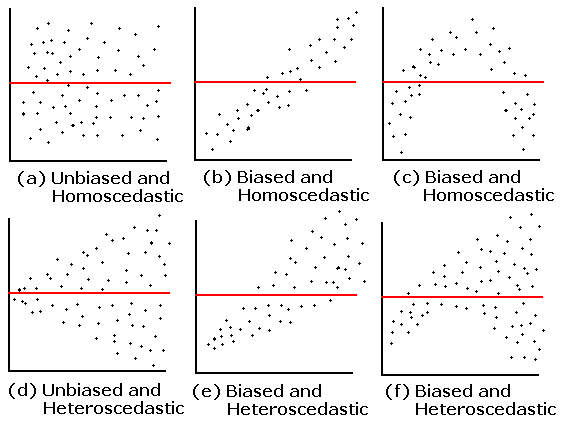

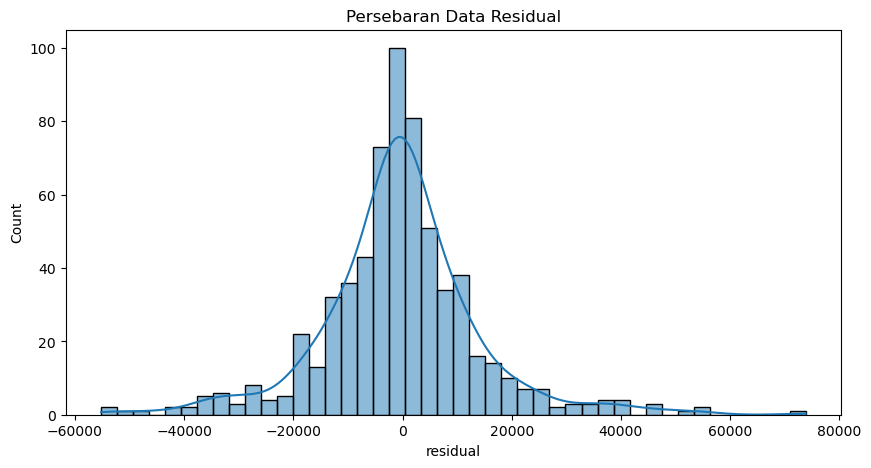

In [56]:
df_error = pd.DataFrame({

    'y_pred' : y_pred_after,
    'residual' : (y_test- y_pred_after)

})
plt.figure(figsize=(10, 5))
sns.histplot(df_error,x='residual',kde=True)
plt.title('Persebaran Data Residual')
plt.show()

In [57]:
skewness = df_error['residual'].skew()

#Conclusion
if skewness == 0:
    print(f"Skew Test Result is {skewness} which mean table Distribution is Normal")
elif skewness > 0:
    print(f"Skew Test Result is {skewness} which mean table Distribution is NOT Normal and RIGHT Skewed")
elif skewness < 0:
    print(f"Skew Test Result is {skewness} which mean table Distribution is NOT Normal and LEFT Skewed")


Skew Test Result is 0.30410980133758664 which mean table Distribution is NOT Normal and RIGHT Skewed


In [58]:
kurtosis = df_error['residual'].skew()

# conclusion
if kurtosis > 0:
    print(f'''Kurtosis = {kurtosis}. Merupakan Lepto kurtic''')
elif kurtosis == 0:
    print(f'''Kurtosis = {kurtosis}. Merupakan Meso Kurtic or Normal''')
elif kurtosis < 0:
    print(f'''Kurtosis = {kurtosis}. Merupakan Platy kurtic''')

Kurtosis = 0.30410980133758664. Merupakan Lepto kurtic


In [59]:
from scipy.stats import shapiro

# Fill Ho and Ha First
Ho = "We assume Data is Normally Distributed" # Ho typically no difference, no effect, no relationship
Ha = "We assume Data is NOT Normally Distributed"

# Put Which function to use here
statistic,pvaluesw = shapiro(df_error['residual'])

#Conclusion
if pvaluesw >= 0.05:
    print(f'''
    pvalue = {pvaluesw}. pvalue >= 0.05. Fail to reject Ho. 
    {Ho}
    ''')
else:
    print(f'''
    pvalue = {pvaluesw}. pvalue < 0.05. Reject Ho. 
    {Ha}''')


    pvalue = 3.4710006270210085e-15. pvalue < 0.05. Reject Ho. 
    We assume Data is NOT Normally Distributed


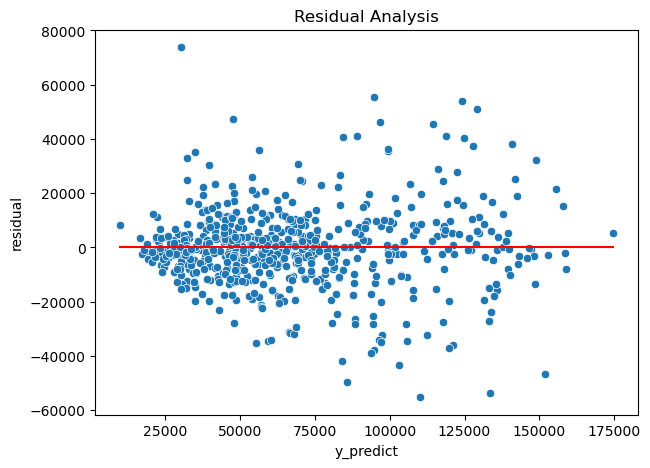

In [60]:
plt.figure(figsize=(7,5))
sns.scatterplot(data=df_error,x=y_pred_after,y='residual')
plt.title('Residual Analysis')
plt.xlabel('y_predict')
sns.lineplot(data=df_error,x=y_pred_after,y=0,color='red')
plt.show()

Data is not normally distributed

Uncorrelated Error
- Terpenuhi, tidak bias/tidak ada pola tertentu

Hetero (constant variable error)
- Tidak terpenuhi, karena bentuknya heteroscedastic

Hasil prediksi model tidak ditemukan bias tetapi masih terdapat heterocedastic yang menandakan model masih kurang baik dalam memprediksi harga mobil di range tertentu.

Bila dilihat dari grafik, model ini cocok untuk mobil dengan range harga menengah yang kemungkinan terjadi karena jumlah data mobil lebih banyak di harga menengah (SAR 10.000 - 80.000)

Terdapat residual yang cukup tinggi, artinya masih terdapat outlier di dalam dataset. Kemungkinan ada mobil dengan tipe yang langka sehingga harganya sangat tinggi.

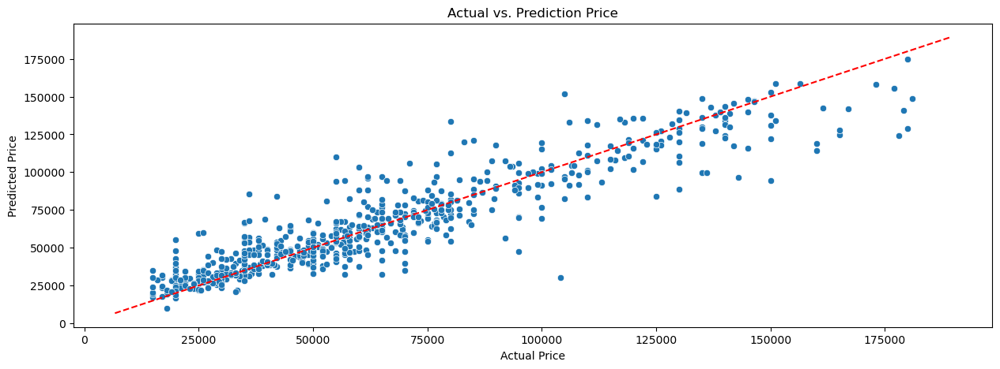

In [61]:
plt.figure(figsize=(15, 5))
plot = sns.scatterplot(x=y_test, y=y_pred_after).set(title='Actual vs. Prediction Price', 
                                               xlabel='Actual Price', 
                                               ylabel='Predicted Price')

xmin, xmax = plt.xlim()
ymin, ymax = plt.ylim()
plt.plot([xmin, xmax], [xmin, xmax], 'r--', label="y = x")  # Red dashed line
plt.show()

Adanya nilai-nilai error yang besar membuat perbedaan yang cukup signifikan antara nilai RMSE dan MAE. Hal ini dapat tergambarkan pada plot di atas, di mana terdapat harga aktual yang rendah tapi diprediksi jauh lebih tinggi (overestimation), dan juga sebaliknya (underestimation).

Akan tetapi, nilai MAPE yang didapat, yaitu sekitar 18% menjadikan model ini dapat dikategorikan ke dalam 'Good forecasting' (Lewis C.D., 1982).

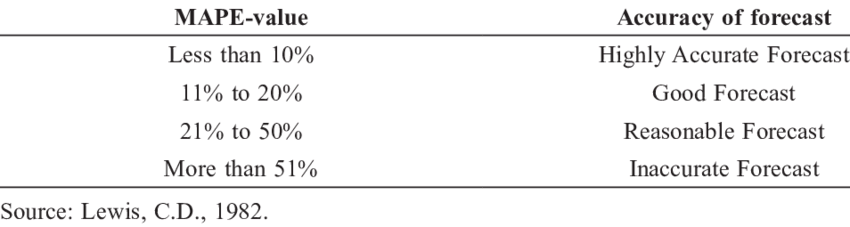

**Feature Importances**

Untuk dapat mengetahui sebenarnya fitur apa saja yang sangat memengaruhi target (`Price`), kita dapat mengeceknya melalui function feature_importances_.

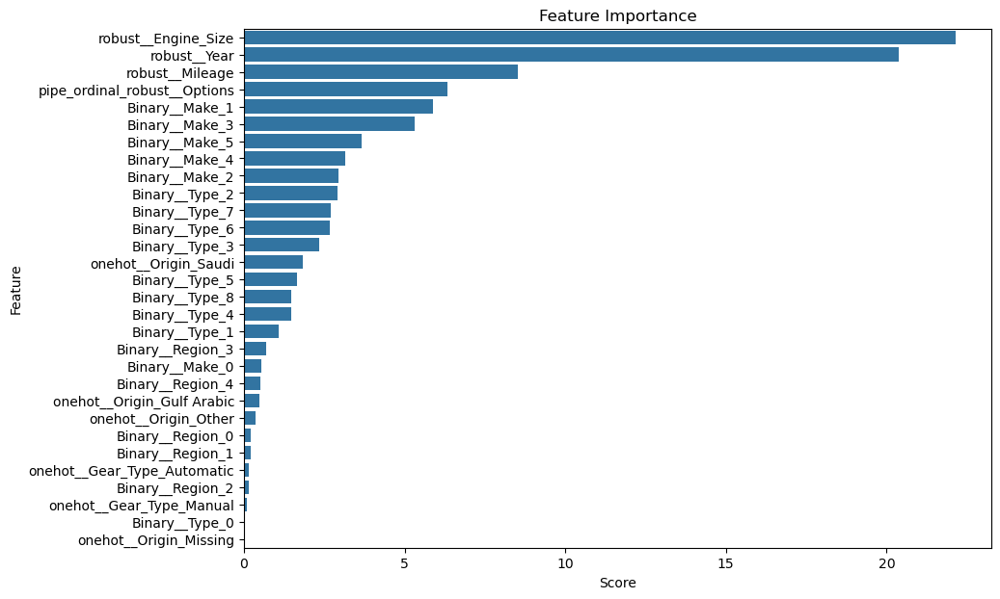

In [62]:
# Plot feature importances
plt.figure(figsize=(10, 7))
feature_imp = pd.DataFrame()
feature_imp['Feature'] = transformer.get_feature_names_out()
feature_imp['Score'] = randomsearch.best_estimator_[-1].feature_importances_

sns.barplot(data= feature_imp.sort_values(by='Score',ascending=False),y='Feature',x='Score')
plt.title('Feature Importance')
plt.show()

Feature paling berpengaruh :
- Engine_Size
- Year
- Mileage 

Ini menandakan bahwa `Engine_Size` atau ukuran mesin mempengaruhi `Price`, `Year` atau tahun mobil dirilis menjadi fitur ke 2 paling berpengaruh, dan yang terakhir adalah `Mileage` jarak tempuh mobil.


**Skor Lebih Besar** : Fitur dengan nilai yang lebih tinggi memberikan kontribusi lebih besar terhadap peningkatan kekuatan prediksi model.

**Skor Lebih Kecil** : Fitur dengan nilai yang lebih kecil memiliki dampak yang lebih sedikit terhadap kinerja model.

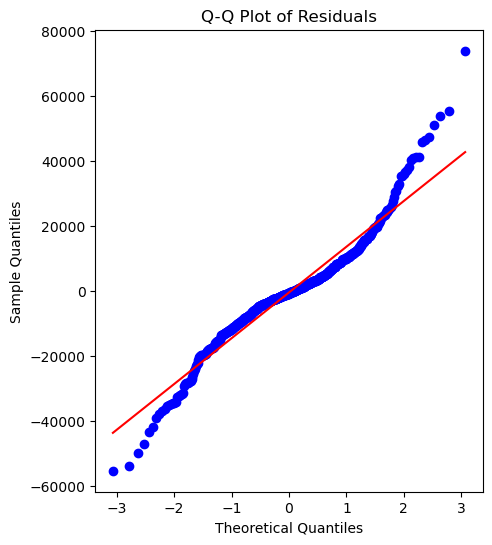

In [63]:
import scipy.stats as stats

# Create a Q-Q plot of the residuals
plt.figure(figsize=(5, 6))
stats.probplot(df_error['residual'], dist="norm", plot=plt)
plt.title('Q-Q Plot of Residuals')
plt.xlabel('Theoretical Quantiles')
plt.ylabel('Sample Quantiles')
plt.show()

**Q-Q Plot of Residuals**

Pada Visualisasi "Q-Q Plot of Residuals" bisa diliat terdapat titik yang menyimpang cukup jauh dari garis merah terutama di kanan atas dan kiri bawah, ini bisa menandakan bahwa masih adanya data outlier.

# **Conclusion**

Berdasarkan model yang telah dibuat, fitur `Engine_Size`, `Year` dan `Mileage` yang paling berpengaruh terhadap `Price`.

Model terbaik adalah CatBooster dengan paramater yang sudah dilakukan tuning.

Dengan menggunakan matrik evaluasi MAE, MAPE, R2 dan MAPE. Bila dilihat dari nilai MAPE yang sudah dilakukan hyperparameter tuning, yaitu sebesar 18%. Kita dapat mengambil kesimpulan bahwa bila nanti model ini digunakan untuk memperkirakan data mobil yang baru dengan rentang harga Nilai Price minimum 15.000 dan max 182.500. Maka perkiraan rata-rata akan meleset kurang lebih sebesar 18% dari harga sebenarnya.

Tapi ada kemungkinan juga hasil prediksi meleset jauh karena bila dilihat dari visualisasi harga aktual dan prediksi dan juga residual terdapat bias yang terjadi. Hal ini bisa terjadi karena terbatasnya fitur pada dataset yang bisa merepresentasikan kondisi mobil, seperti kondisi luar mobil, berapa kali turun mesin, kondisi interior mobil, pernah tabrakan atau tidak dan lain lain.

Model ini masih bisa disempurnakan lagi sehingga menghasilkan prediksi yang lebih baik. Kedepannya kita dapat mencoba untuk membandingkan hasil prediksi model ini dengan peningkatan akurasi harga mobil dari Appraiser.

- **Model Baik digunakan Saat**
    - Memperkirakan harga mobil bekas yang fiturnya dalam rentang **Price** SAR 15.000 - 182.500 , **Mileage** dibawah 376.000 KM, **Year** 2003 - 2021 dan Tidak Negotiable

- **Model Tidak Baik digunakan Saat**
    - Memperkirakan harga mobil diluar spesifikasi di atas seperti mobil edisi terbatas, mobil antik atau mobil yang sudah dimodifikasi.

**Cost Calculation**

- Perusahaan Syarah.com :
    - Dengan adanya Model Machine Learning ini, perusahan dapat menghemat dengan tanpa menghire karyawan Appraiser. Dari misal perusahaan harus menghire 10 orang tambahan untuk menambah team Appraiser, Perusahaan hanya perlu 1 Data Science untuk memelihara dan mengupgrade Model Machine Learning ketika ada data baru.
    Perusahaan bisa menghemat dari 10 * SAR 8.000 (80.000 / bulan) menjadi 1 * SAR 12.000 (12.000 / bulan)
- Calon Penjual Mobil Bekas :
    - Calon Penjual dapat mendapatkan estimasi harga mobilnya diawal sebelum yakin untuk menjual mobilnya di Syarah.com. Ini akan meningkatkan kemungkinan calon penjual akan menjual mobilnya, dan juga akan menambahkan profit dari perusahaan Syarah.com itu sendiri dengan semakin banyaknya mobil yang bisa di listing.

# **Recommendations**

**a. For Model**
1. Melakukan pengecekan fitur mana saja yang paling berpengaruh terhadap target ‘Price’, dengan demikian model yang dibuat akan lebih baik untuk memprediksi ‘Price’.
<br><br>
2. Mencoba untuk mengelompokan mobil dengan rentang harga tertentu sehingga kita bisa mengetahui model yang paling cocok untuk setiap kelompok harga mobil
<br><br>
3. Mencoba mengisi data mobil Negotiable dengan menggunakan Machine Learning/Deep Learning, sehingga data tersebut dapat digunakan.
<br><br>
4. Jika memungkinkan menambahkan fitur yang lebih menggambarkan kondisi mobil seperti kondisi luar mobil, berapa kali turun mesin, kondisi interior mobil, pernah tabrakan atau tidak  dan lainnya.
<br><br>
5. Melakukan penambahan data dengan data yang lengkap, karena di dataset ini walaupun di awal ada sekitar 5.600 data tetapi setelah melakukan cleaning yang bisa digunakan hanya 3.192 data yang kurang banyak untuk mendapatkan hasil prediksi yang baik.
<br><br>
6. Mengintegrasi model ke website Syarah.com / ke internal tools
<br><br>

**b. For Business**

1. Kedepannya model ini dapat digunakan sebagai pembanding untuk pengembangan model yang lain seperti memprediksi pengelompokan mobil mana saja yang paling banyak dibeli oleh pelanggan. Model tersebut bermanfaat untuk pengaturan mobil yang dijual di platform Syarah.com
<br><br>
2. Menambahkan fitur upload gambar di website Syarah.com ketika calon penjual akan menjual mobilnya. Ini akan mempermudah Team untuk memperkirakan hasil dan bisa juga mengimplementasikan Computer Vision.


# CatBoost Model

CatBoost (Categorical Boosting) adalah algoritma gradient boosting yang dikembangkan oleh Yandex untuk menangani fitur kategorikal secara efisien tanpa memerlukan preprocessing yang rumit seperti one-hot encoding. Algoritma ini menggunakan teknik ordered boosting, yang memastikan model tidak mengalami data leakage selama pelatihan.

Ordered boosting bekerja dengan membangun model secara bertahap, hanya menggunakan informasi dari data yang muncul sebelum titik data tertentu dalam urutan pelatihan, sehingga mencegah overfitting. Data di pohon selanjutnya hanya akan mengginakan subset/sebagian dari pohon sebelumnya. Sehingga dapat menghindari overfitting.

CatBoost, yang dibuat oleh Yandex, banyak digunakan untuk tugas klasifikasi dan regresi, menawarkan akurasi yang kompetitif, pelatihan yang cepat, dan kemudahan integrasi ke dalam workflow.

# **Explainable Model**

Di sini kita akan menggunakan LIME dan SHAP untuk mencari tahu bagaimana cara Model CatBoost bekerja di dataset ini.

LIME akan menjelaskan bobot dari setiap fitur kepada prediksi harga akhir. Dan dengan LIME kita akan mengecek 1 contoh data.

Untuk SHAP akan digunakan untuk menggambarkan secara keseluruhan bobot setiap fitur.

In [64]:
import lime
from lime import lime_tabular

# Base Classifier

rf_lime = best_model.named_steps['modeling']
# Extract the preprocessing transformer (adjust based on your pipeline structure)
preprocessor = best_model.named_steps['preprocessing']

# Apply the preprocessing to the test set
X_test_transformed = preprocessor.transform(X_test)


best_model.fit(X_train, y_train)
score = rf_lime.score(X_test_transformed, y_test)

0:	learn: 37383.9173715	total: 4.08ms	remaining: 4.08s
1:	learn: 36423.3362717	total: 7.4ms	remaining: 3.69s
2:	learn: 35554.4020693	total: 10.7ms	remaining: 3.55s
3:	learn: 34688.4199737	total: 13.6ms	remaining: 3.39s
4:	learn: 33828.3420568	total: 16.7ms	remaining: 3.33s
5:	learn: 33002.9473787	total: 20.3ms	remaining: 3.37s
6:	learn: 32235.7591483	total: 23.3ms	remaining: 3.31s
7:	learn: 31415.8019088	total: 26.5ms	remaining: 3.29s
8:	learn: 30704.6951377	total: 29.5ms	remaining: 3.25s
9:	learn: 30112.6422879	total: 32.5ms	remaining: 3.21s
10:	learn: 29527.0653440	total: 35.7ms	remaining: 3.21s
11:	learn: 28960.3021121	total: 38.5ms	remaining: 3.17s
12:	learn: 28436.6328162	total: 41.4ms	remaining: 3.14s
13:	learn: 27803.3741207	total: 44.4ms	remaining: 3.13s
14:	learn: 27285.2694494	total: 47.4ms	remaining: 3.11s
15:	learn: 26846.5604209	total: 50.4ms	remaining: 3.1s
16:	learn: 26392.0118517	total: 53.4ms	remaining: 3.08s
17:	learn: 25960.5254238	total: 56.1ms	remaining: 3.06s
18:	

**Data X_test iloc 0**

Kita akan mengecek data X_test, hasil prediksi adalah 90.835. Berikut adalah penjelasan detail komposisi dari price yang didapat.

In [65]:
y_test

1634    93500
2991    15000
816     19000
847     50000
538     20000
        ...  
2260    15000
3930    30000
5374    70000
3389    88000
2034    30000
Name: Price, Length: 639, dtype: int64

In [66]:
X_train_transformed = preprocessor.transform(X_train)

# Explainer based
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train_transformed),
    feature_names=preprocessor.get_feature_names_out(),
    mode='regression'
)

pred = best_model.predict(X_test.iloc[[0]])[0]

In [67]:
df_testing = X_test.iloc[[0]]
df_testing["Predict"] = [pred]
df_testing

/var/folders/dt/mp18g7bj3fs8hm27kth1hcvw0000gn/T/ipykernel_36827/825187265.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_testing["Predict"] = [pred]


,Type,Region,Make,Gear_Type,Origin,Options,Year,Engine_Size,Mileage,Predict
1634,Land Cruiser Pickup,Riyadh,Toyota,Manual,Gulf Arabic,Full,2016,4.00,243038,103688.28


In [68]:
# Select an instance to explain
instance_idx = 0
instance_to_explain = X_test_transformed[instance_idx]

# Generate explanation for the selected instance
explanation = explainer.explain_instance(
    instance_to_explain,
    rf_lime.predict,  # Use `model.predict` for regression tasks
    num_features=10
)

# Display the explanation
plt.figure(figsize=(5, 6))
explanation.show_in_notebook(show_table=True)


<Figure size 500x600 with 0 Axes>

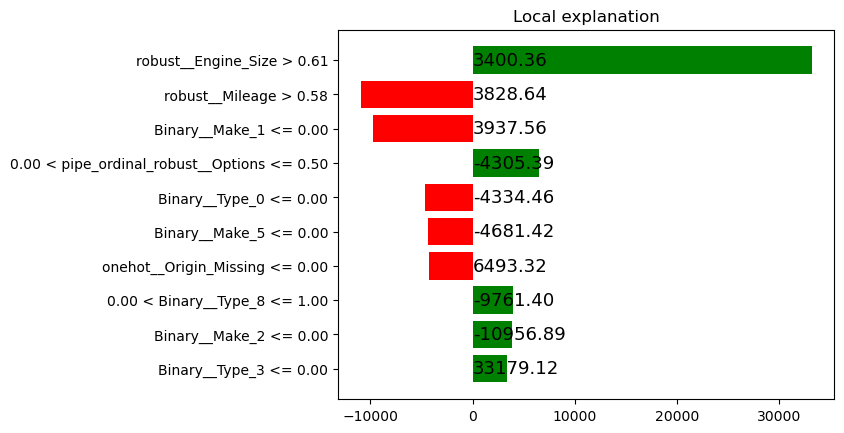

In [69]:
# Plot the explanation
fig = explanation.as_pyplot_figure()

# Extract only the importance scores from exp.as_list()
feature_importances = explanation.as_list()
importance_scores = [importance for _, importance in feature_importances]

# Annotate the plot with the importance scores
for i, importance in enumerate(importance_scores):
    plt.annotate(
        f'{importance:.2f}',  # Importance score to annotate
        xy=(1000, 10),  # Position based on the importance and feature index
        xytext=(30 , i+0.5),  # Offset to the right for better readability
        ha='left',  # Horizontal alignment
        va='center',  # Vertical alignment
        fontsize=13,  # Font size for clarity
        # arrowprops=dict(facecolor='gray', arrowstyle='->', lw=0.5),  # Optional arrow
    )

# Show the plot
plt.show()


Cara Membaca LIME
---

Bisa dilihat di bagian kanan untuk data contoh ini fitur yang paling berpengaruh, warna Orange akan membuat prediksi harga positive dan warna biru prediksi negatif.

Semakin tinggi nilai Engine akan mengarah ke semakin mahal harga mobil, dan semakin tinggi Mileage akan membuat harga mobil semakin murah.

Dibagian tengah kita bisa melihat bobot yang diberikan dari tiap feature, untuk melihat hasilnya ada di bagian kiri untuk predicted value

Bila kita menjumlahkan semua Feature yang ada makan kita akan mendapatkan harga prediksi, untuk X_train iloc 0 akan menghasilkan 90.835

***


 99%|===================| 632/639 [00:51<00:00]        

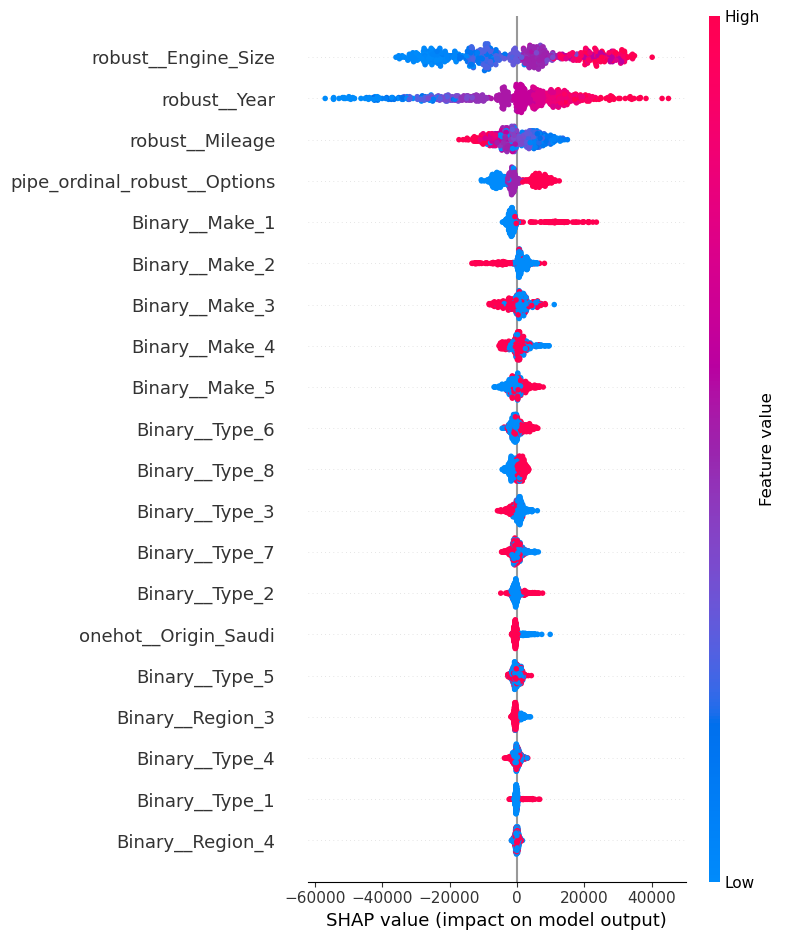

In [70]:
import shap

# Extract the model from the pipeline
model = best_model.named_steps['modeling']

# Extract the preprocessing transformer (adjust based on your pipeline structure)
preprocessor = best_model.named_steps['preprocessing']

# Apply the preprocessing to the test set
X_test_transformed = preprocessor.transform(X_test)

# Extract feature names after transformation (use get_feature_names_out if using ColumnTransformer)
if hasattr(preprocessor, 'get_feature_names_out'):
    feature_names = preprocessor.get_feature_names_out()
else:
    feature_names = X_test.columns  # Use original feature names if no transformation is applied

# Create a SHAP explainer for the model
explainer = shap.Explainer(model, X_test_transformed)

# Calculate SHAP values
shap_values = explainer(X_test_transformed)

# Convert SHAP values to a numpy array
shap_values_array = shap_values.values

# Set feature names for SHAP (ensuring the transformed feature names are used)
shap_values.feature_names = feature_names

# # Plot the SHAP values for the first prediction
# shap.plots.waterfall(shap_values[0])

# Summary plot of SHAP values for all predictions
shap.summary_plot(shap_values, X_test_transformed)


Cara Membaca SHAP
---

Warna merah akan berkontribusi harga lebih ke mahal dan warna biru ke arah harga lebih murah/negative.

Untuk setiap data, kita akan melihat posisi data tersebut di setiap fiturnya. Ketika berwarna merah, akan mendapat tambahan harga sedangkan bila di sisi biru akan mengurangi harga.

Untuk urutan kontribusinya sesuai dengan Feature Importance yang ada.

***

# **Save Model**

Di sini kita akan melakukan export model dengan paramater terbaik agar bisa digunakan untuk deployment.

In [71]:
# Import Library Pickle
import pickle

In [72]:
# Save model

#fit
best_model.fit(X, y)

# save with pickle
pickle.dump(best_model, open('Model_Saudi_Arabia_Used_Cars.sav', 'wb'))

0:	learn: 37083.9149393	total: 4.22ms	remaining: 4.22s
1:	learn: 36178.6747079	total: 7.51ms	remaining: 3.75s
2:	learn: 35354.7526071	total: 10.5ms	remaining: 3.5s
3:	learn: 34567.3201335	total: 13.7ms	remaining: 3.41s
4:	learn: 33777.7282671	total: 16.8ms	remaining: 3.34s
5:	learn: 33005.3471150	total: 19.6ms	remaining: 3.25s
6:	learn: 32288.2611421	total: 23ms	remaining: 3.26s
7:	learn: 31616.4747223	total: 26.2ms	remaining: 3.24s
8:	learn: 30993.2074168	total: 29.4ms	remaining: 3.23s
9:	learn: 30388.5359239	total: 32.4ms	remaining: 3.21s
10:	learn: 29775.9924642	total: 35.5ms	remaining: 3.19s
11:	learn: 29284.3382454	total: 38.6ms	remaining: 3.18s
12:	learn: 28635.0889091	total: 42.2ms	remaining: 3.2s
13:	learn: 28119.5332232	total: 45ms	remaining: 3.17s
14:	learn: 27572.2169432	total: 48ms	remaining: 3.15s
15:	learn: 27173.3452183	total: 51.2ms	remaining: 3.15s
16:	learn: 26760.3877738	total: 54.6ms	remaining: 3.15s
17:	learn: 26370.5873439	total: 57.6ms	remaining: 3.14s
18:	learn:

**Testing Exported Model**

In [73]:
# Load model
filename = 'Model_Saudi_Arabia_Used_Cars.sav'
loaded_model = pickle.load(open(filename, 'rb'))
loaded_model

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('pipe_ordinal_robust',
                                                  Pipeline(steps=[('ordinal',
                                                                   OrdinalEncoder(mapping=[{'col': 'Options',
                                                                                            'data_type': dtype('O'),
                                                                                            'mapping': Standard     1
Semi Full    2
Full         3
dtype: int64}])),
                                                                  ('robust',
                                                                   RobustScaler())]),
                                                  ['Options']),
                                                 ('Binary', BinaryEncoder(),
                                                  ['Type', 'Region', 'Make']),
                                                 ('robust', RobustScaler(),
                                                  ['Mileage', 'Engine_Size',
                                                   'Year']),
                                                 ('onehot',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['Gear_Type', 'Origin'])])),
                ('modeling',
                 <catboost.core.CatBoostRegressor object at 0x3158809e0>)])

In [74]:
df.iloc[[0]]

,Type,Region,Make,Gear_Type,Origin,Options,Year,Engine_Size,Mileage,Negotiable,Price
1,Yukon,Riyadh,GMC,Automatic,Saudi,Full,2014,8.00,80000,False,120000


In [75]:
loaded_model.predict(df.iloc[[0]])

array([120477.1621576])

# **Deploy Model**

Model ini bisa diterapkan di 2 fase, yang pertama adalah saat Calon Penjual akan menjual mobil baik di website atau di aplikasi dan selanjutnya ketika appraiser akan memberikan harga.

Untuk Calon penjual bisa menggunakan fitur seperti di bagian **Calculator for Costumer**

Untuk Team Appraiser bisa menggunakan fitur seperti di bagian **Calculator Batch Upload for Team** yang dilengkapi dengan fitur upload csv

Salah satu pengaplikasiannya sudah saya siapkan di dalam file .py yang bisa dirun menggunakan Streamlit.

Cara menggunakan :
1. Open Folder Streamlit yang bisa didownload dari Github : [Download Here](https://github.com/glenvj-j/Saudi-Arabia-Used-Car-Regression-Prediction/tree/main/Streamlit)
2. Run Homepage.py
3. Program sudah bisa digunakan

Atau bisa membuka link berikut : [Deployed App](https://saudi-arabia-used-car.streamlit.app/)